# Project 2 - Ames Housing Data and Kaggle (Data cleaning, EDA and Feature Engineering)

## Problem Statement

In order to build an optimum model to predict the sale price of Ames housing, selection of features for the model is essential for the task.

## Executive Summary

### Contents:
- [Data Import](#Data-Import)
- [Data Cleaning and EDA for Train Data](#Data-Cleaning-and-EDA-for-Train-Data)
- [Feature Engineering, Selection and further EDA](#Feature-Engineering,-Selection-and-further-EDA)
- [Data Cleaning for Test Data](#Data-Cleaning-for-Test-Data)
- [Sources](#Sources)
- [Conclusions](#Conclusions)

In [74]:
#Imports:
import numpy as np
import matplotlib.pyplot as plt
import scipy.stats as stats
import seaborn as sns
import pandas as pd
from sklearn import metrics
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler

pd.set_option('display.max_rows', 5000)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

## Data Import

#### Read In test.csv and train.csv

In [75]:
test = pd.read_csv('datasets/test.csv')
train = pd.read_csv('datasets/train.csv')


## Data Cleaning and EDA for Train Data

In [76]:
print(test.shape)
print(train.shape)


(879, 80)
(2051, 81)


In [77]:
train.head()

,Id,PID,MS SubClass,MS Zoning,Lot Frontage,Lot Area,Street,Alley,Lot Shape,Land Contour,Utilities,Lot Config,Land Slope,Neighborhood,Condition 1,Condition 2,Bldg Type,House Style,Overall Qual,Overall Cond,Year Built,Year Remod/Add,Roof Style,Roof Matl,Exterior 1st,Exterior 2nd,Mas Vnr Type,Mas Vnr Area,Exter Qual,Exter Cond,Foundation,Bsmt Qual,Bsmt Cond,Bsmt Exposure,BsmtFin Type 1,BsmtFin SF 1,BsmtFin Type 2,BsmtFin SF 2,Bsmt Unf SF,Total Bsmt SF,Heating,Heating QC,Central Air,Electrical,1st Flr SF,2nd Flr SF,Low Qual Fin SF,Gr Liv Area,Bsmt Full Bath,Bsmt Half Bath,Full Bath,Half Bath,Bedroom AbvGr,Kitchen AbvGr,Kitchen Qual,TotRms AbvGrd,Functional,Fireplaces,Fireplace Qu,Garage Type,Garage Yr Blt,Garage Finish,Garage Cars,Garage Area,Garage Qual,Garage Cond,Paved Drive,Wood Deck SF,Open Porch SF,Enclosed Porch,3Ssn Porch,Screen Porch,Pool Area,Pool QC,Fence,Misc Feature,Misc Val,Mo Sold,Yr Sold,Sale Type,SalePrice
0,109,533352170,60,RL,NaN,13517,Pave,NaN,IR1,Lvl,AllPub,CulDSac,Gtl,Sawyer,RRAe,Norm,1Fam,2Story,6,8,1976,2005,Gable,CompShg,HdBoard,Plywood,BrkFace,289.0,Gd,TA,CBlock,TA,TA,No,GLQ,533.0,Unf,0.0,192.0,725.0,GasA,Ex,Y,SBrkr,725,754,0,1479,0.0,0.0,2,1,3,1,Gd,6,Typ,0,NaN,Attchd,1976.0,RFn,2.0,475.0,TA,TA,Y,0,44,0,0,0,0,NaN,NaN,NaN,0,3,2010,WD,130500
1,544,531379050,60,RL,43.0,11492,Pave,NaN,IR1,Lvl,AllPub,CulDSac,Gtl,SawyerW,Norm,Norm,1Fam,2Story,7,5,1996,1997,Gable,CompShg,VinylSd,VinylSd,BrkFace,132.0,Gd,TA,PConc,Gd,TA,No,GLQ,637.0,Unf,0.0,276.0,913.0,GasA,Ex,Y,SBrkr,913,1209,0,2122,1.0,0.0,2,1,4,1,Gd,8,Typ,1,TA,Attchd,1997.0,RFn,2.0,559.0,TA,TA,Y,0,74,0,0,0,0,NaN,NaN,NaN,0,4,2009,WD,220000
2,153,535304180,20,RL,68.0,7922,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,5,7,1953,2007,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,Gd,CBlock,TA,TA,No,GLQ,731.0,Unf,0.0,326.0,1057.0,GasA,TA,Y,SBrkr,1057,0,0,1057,1.0,0.0,1,0,3,1,Gd,5,Typ,0,NaN,Detchd,1953.0,Unf,1.0,246.0,TA,TA,Y,0,52,0,0,0,0,NaN,NaN,NaN,0,1,2010,WD,109000
3,318,916386060,60,RL,73.0,9802,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Timber,Norm,Norm,1Fam,2Story,5,5,2006,2007,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,PConc,Gd,TA,No,Unf,0.0,Unf,0.0,384.0,384.0,GasA,Gd,Y,SBrkr,744,700,0,1444,0.0,0.0,2,1,3,1,TA,7,Typ,0,NaN,BuiltIn,2007.0,Fin,2.0,400.0,TA,TA,Y,100,0,0,0,0,0,NaN,NaN,NaN,0,4,2010,WD,174000
4,255,906425045,50,RL,82.0,14235,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,SawyerW,Norm,Norm,1Fam,1.5Fin,6,8,1900,1993,Gable,CompShg,Wd Sdng,Plywood,None,0.0,TA,TA,PConc,Fa,Gd,No,Unf,0.0,Unf,0.0,676.0,676.0,GasA,TA,Y,SBrkr,831,614,0,1445,0.0,0.0,2,0,3,1,TA,6,Typ,0,NaN,Detchd,1957.0,Unf,2.0,484.0,TA,TA,N,0,59,0,0,0,0,NaN,NaN,NaN,0,3,2010,WD,138500


In [78]:
train['Id'].nunique()
#Id and PID is not related to Sale Price and should be unique, check that all is unique and no duplicate then drop the column

2051

In [79]:
train.drop(columns=['Id','PID'],inplace=True) #drop Id and PID which do not help in predicting sale price

In [80]:
train.columns #check if columns dropped

Index(['MS SubClass', 'MS Zoning', 'Lot Frontage', 'Lot Area', 'Street', 'Alley', 'Lot Shape', 'Land Contour', 'Utilities', 'Lot Config', 'Land Slope', 'Neighborhood', 'Condition 1', 'Condition 2', 'Bldg Type', 'House Style', 'Overall Qual', 'Overall Cond', 'Year Built', 'Year Remod/Add', 'Roof Style', 'Roof Matl', 'Exterior 1st', 'Exterior 2nd', 'Mas Vnr Type', 'Mas Vnr Area', 'Exter Qual', 'Exter Cond', 'Foundation', 'Bsmt Qual', 'Bsmt Cond', 'Bsmt Exposure', 'BsmtFin Type 1', 'BsmtFin SF 1', 'BsmtFin Type 2', 'BsmtFin SF 2', 'Bsmt Unf SF', 'Total Bsmt SF', 'Heating', 'Heating QC', 'Central Air', 'Electrical', '1st Flr SF', '2nd Flr SF', 'Low Qual Fin SF', 'Gr Liv Area', 'Bsmt Full Bath', 'Bsmt Half Bath', 'Full Bath', 'Half Bath', 'Bedroom AbvGr', 'Kitchen AbvGr', 'Kitchen Qual', 'TotRms AbvGrd', 'Functional', 'Fireplaces', 'Fireplace Qu', 'Garage Type', 'Garage Yr Blt', 'Garage Finish', 'Garage Cars', 'Garage Area', 'Garage Qual', 'Garage Cond', 'Paved Drive', 'Wood Deck SF',
     

In [81]:
#Remove the spaces in column names and make into all lowercase
def remove_spaces(df_col_list):
    for col in df_col_list:
        col.replace(" ","")


train.columns = train.columns.map(lambda col: (col.replace(' ','')).lower())

In [82]:
train.columns #check if all lowercase and spaces has been removed

Index(['mssubclass', 'mszoning', 'lotfrontage', 'lotarea', 'street', 'alley', 'lotshape', 'landcontour', 'utilities', 'lotconfig', 'landslope', 'neighborhood', 'condition1', 'condition2', 'bldgtype', 'housestyle', 'overallqual', 'overallcond', 'yearbuilt', 'yearremod/add', 'roofstyle', 'roofmatl', 'exterior1st', 'exterior2nd', 'masvnrtype', 'masvnrarea', 'exterqual', 'extercond', 'foundation', 'bsmtqual', 'bsmtcond', 'bsmtexposure', 'bsmtfintype1', 'bsmtfinsf1', 'bsmtfintype2', 'bsmtfinsf2', 'bsmtunfsf', 'totalbsmtsf', 'heating', 'heatingqc', 'centralair', 'electrical', '1stflrsf', '2ndflrsf', 'lowqualfinsf', 'grlivarea', 'bsmtfullbath', 'bsmthalfbath', 'fullbath', 'halfbath', 'bedroomabvgr', 'kitchenabvgr', 'kitchenqual', 'totrmsabvgrd', 'functional', 'fireplaces', 'fireplacequ', 'garagetype', 'garageyrblt', 'garagefinish', 'garagecars', 'garagearea', 'garagequal', 'garagecond', 'paveddrive', 'wooddecksf', 'openporchsf', 'enclosedporch', '3ssnporch', 'screenporch', 'poolarea',
       

In [83]:
train.head()

,mssubclass,mszoning,lotfrontage,lotarea,street,alley,lotshape,landcontour,utilities,lotconfig,landslope,neighborhood,condition1,condition2,bldgtype,housestyle,overallqual,overallcond,yearbuilt,yearremod/add,roofstyle,roofmatl,exterior1st,exterior2nd,masvnrtype,masvnrarea,exterqual,extercond,foundation,bsmtqual,bsmtcond,bsmtexposure,bsmtfintype1,bsmtfinsf1,bsmtfintype2,bsmtfinsf2,bsmtunfsf,totalbsmtsf,heating,heatingqc,centralair,electrical,1stflrsf,2ndflrsf,lowqualfinsf,grlivarea,bsmtfullbath,bsmthalfbath,fullbath,halfbath,bedroomabvgr,kitchenabvgr,kitchenqual,totrmsabvgrd,functional,fireplaces,fireplacequ,garagetype,garageyrblt,garagefinish,garagecars,garagearea,garagequal,garagecond,paveddrive,wooddecksf,openporchsf,enclosedporch,3ssnporch,screenporch,poolarea,poolqc,fence,miscfeature,miscval,mosold,yrsold,saletype,saleprice
0,60,RL,NaN,13517,Pave,NaN,IR1,Lvl,AllPub,CulDSac,Gtl,Sawyer,RRAe,Norm,1Fam,2Story,6,8,1976,2005,Gable,CompShg,HdBoard,Plywood,BrkFace,289.0,Gd,TA,CBlock,TA,TA,No,GLQ,533.0,Unf,0.0,192.0,725.0,GasA,Ex,Y,SBrkr,725,754,0,1479,0.0,0.0,2,1,3,1,Gd,6,Typ,0,NaN,Attchd,1976.0,RFn,2.0,475.0,TA,TA,Y,0,44,0,0,0,0,NaN,NaN,NaN,0,3,2010,WD,130500
1,60,RL,43.0,11492,Pave,NaN,IR1,Lvl,AllPub,CulDSac,Gtl,SawyerW,Norm,Norm,1Fam,2Story,7,5,1996,1997,Gable,CompShg,VinylSd,VinylSd,BrkFace,132.0,Gd,TA,PConc,Gd,TA,No,GLQ,637.0,Unf,0.0,276.0,913.0,GasA,Ex,Y,SBrkr,913,1209,0,2122,1.0,0.0,2,1,4,1,Gd,8,Typ,1,TA,Attchd,1997.0,RFn,2.0,559.0,TA,TA,Y,0,74,0,0,0,0,NaN,NaN,NaN,0,4,2009,WD,220000
2,20,RL,68.0,7922,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,5,7,1953,2007,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,Gd,CBlock,TA,TA,No,GLQ,731.0,Unf,0.0,326.0,1057.0,GasA,TA,Y,SBrkr,1057,0,0,1057,1.0,0.0,1,0,3,1,Gd,5,Typ,0,NaN,Detchd,1953.0,Unf,1.0,246.0,TA,TA,Y,0,52,0,0,0,0,NaN,NaN,NaN,0,1,2010,WD,109000
3,60,RL,73.0,9802,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Timber,Norm,Norm,1Fam,2Story,5,5,2006,2007,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,PConc,Gd,TA,No,Unf,0.0,Unf,0.0,384.0,384.0,GasA,Gd,Y,SBrkr,744,700,0,1444,0.0,0.0,2,1,3,1,TA,7,Typ,0,NaN,BuiltIn,2007.0,Fin,2.0,400.0,TA,TA,Y,100,0,0,0,0,0,NaN,NaN,NaN,0,4,2010,WD,174000
4,50,RL,82.0,14235,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,SawyerW,Norm,Norm,1Fam,1.5Fin,6,8,1900,1993,Gable,CompShg,Wd Sdng,Plywood,None,0.0,TA,TA,PConc,Fa,Gd,No,Unf,0.0,Unf,0.0,676.0,676.0,GasA,TA,Y,SBrkr,831,614,0,1445,0.0,0.0,2,0,3,1,TA,6,Typ,0,NaN,Detchd,1957.0,Unf,2.0,484.0,TA,TA,N,0,59,0,0,0,0,NaN,NaN,NaN,0,3,2010,WD,138500


In [84]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2051 entries, 0 to 2050
Data columns (total 79 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   mssubclass     2051 non-null   int64  
 1   mszoning       2051 non-null   object 
 2   lotfrontage    1721 non-null   float64
 3   lotarea        2051 non-null   int64  
 4   street         2051 non-null   object 
 5   alley          140 non-null    object 
 6   lotshape       2051 non-null   object 
 7   landcontour    2051 non-null   object 
 8   utilities      2051 non-null   object 
 9   lotconfig      2051 non-null   object 
 10  landslope      2051 non-null   object 
 11  neighborhood   2051 non-null   object 
 12  condition1     2051 non-null   object 
 13  condition2     2051 non-null   object 
 14  bldgtype       2051 non-null   object 
 15  housestyle     2051 non-null   object 
 16  overallqual    2051 non-null   int64  
 17  overallcond    2051 non-null   int64  
 18  yearbuil

Checked all columns datatypes and mssubclass should be a categorial type and features like overallqual ad overallcond can assume to be continous as the have even value between each point. I also see that there are many missing values.

#### Changing data type

In [85]:
train['mssubclass'] = train['mssubclass'].astype(object)


In [86]:
train.dtypes #check if it has been changed

mssubclass        object
mszoning          object
lotfrontage      float64
lotarea            int64
street            object
alley             object
lotshape          object
landcontour       object
utilities         object
lotconfig         object
landslope         object
neighborhood      object
condition1        object
condition2        object
bldgtype          object
housestyle        object
overallqual        int64
overallcond        int64
yearbuilt          int64
yearremod/add      int64
roofstyle         object
roofmatl          object
exterior1st       object
exterior2nd       object
masvnrtype        object
masvnrarea       float64
exterqual         object
extercond         object
foundation        object
bsmtqual          object
bsmtcond          object
bsmtexposure      object
bsmtfintype1      object
bsmtfinsf1       float64
bsmtfintype2      object
bsmtfinsf2       float64
bsmtunfsf        float64
totalbsmtsf      float64
heating           object
heatingqc         object


#### Checking for outliers

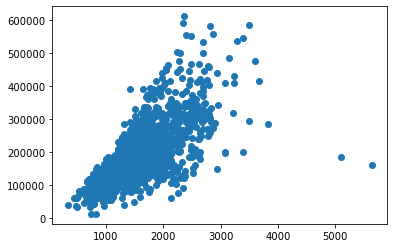

In [87]:
plt.scatter(train['grlivarea'],train['saleprice'])

We can see 2 obvious outliers that are more than 4000 sqft in relation to the saleprice. We can drop these 2 outliers.

In [88]:
train.shape

(2051, 79)

In [89]:
train.loc[train['grlivarea']>4000]

,mssubclass,mszoning,lotfrontage,lotarea,street,alley,lotshape,landcontour,utilities,lotconfig,landslope,neighborhood,condition1,condition2,bldgtype,housestyle,overallqual,overallcond,yearbuilt,yearremod/add,roofstyle,roofmatl,exterior1st,exterior2nd,masvnrtype,masvnrarea,exterqual,extercond,foundation,bsmtqual,bsmtcond,bsmtexposure,bsmtfintype1,bsmtfinsf1,bsmtfintype2,bsmtfinsf2,bsmtunfsf,totalbsmtsf,heating,heatingqc,centralair,electrical,1stflrsf,2ndflrsf,lowqualfinsf,grlivarea,bsmtfullbath,bsmthalfbath,fullbath,halfbath,bedroomabvgr,kitchenabvgr,kitchenqual,totrmsabvgrd,functional,fireplaces,fireplacequ,garagetype,garageyrblt,garagefinish,garagecars,garagearea,garagequal,garagecond,paveddrive,wooddecksf,openporchsf,enclosedporch,3ssnporch,screenporch,poolarea,poolqc,fence,miscfeature,miscval,mosold,yrsold,saletype,saleprice
960,60,RL,313.0,63887,Pave,NaN,IR3,Bnk,AllPub,Corner,Gtl,Edwards,Feedr,Norm,1Fam,2Story,10,5,2008,2008,Hip,ClyTile,Stucco,Stucco,Stone,796.0,Ex,TA,PConc,Ex,TA,Gd,GLQ,5644.0,Unf,0.0,466.0,6110.0,GasA,Ex,Y,SBrkr,4692,950,0,5642,2.0,0.0,2,1,3,1,Ex,12,Typ,3,Gd,Attchd,2008.0,Fin,2.0,1418.0,TA,TA,Y,214,292,0,0,0,480,Gd,NaN,NaN,0,1,2008,New,160000
1885,20,RL,128.0,39290,Pave,NaN,IR1,Bnk,AllPub,Inside,Gtl,Edwards,Norm,Norm,1Fam,1Story,10,5,2008,2009,Hip,CompShg,CemntBd,CmentBd,Stone,1224.0,Ex,TA,PConc,Ex,TA,Gd,GLQ,4010.0,Unf,0.0,1085.0,5095.0,GasA,Ex,Y,SBrkr,5095,0,0,5095,1.0,1.0,2,1,2,1,Ex,15,Typ,2,Gd,Attchd,2008.0,Fin,3.0,1154.0,TA,TA,Y,546,484,0,0,0,0,NaN,NaN,Elev,17000,10,2007,New,183850


In [90]:
train.drop(index=[960,1885],inplace=True)

In [91]:
train.shape

(2049, 79)

#### Drop or replace of missing values

In [92]:
train.isnull().sum()

mssubclass          0
mszoning            0
lotfrontage       330
lotarea             0
street              0
alley            1909
lotshape            0
landcontour         0
utilities           0
lotconfig           0
landslope           0
neighborhood        0
condition1          0
condition2          0
bldgtype            0
housestyle          0
overallqual         0
overallcond         0
yearbuilt           0
yearremod/add       0
roofstyle           0
roofmatl            0
exterior1st         0
exterior2nd         0
masvnrtype         22
masvnrarea         22
exterqual           0
extercond           0
foundation          0
bsmtqual           55
bsmtcond           55
bsmtexposure       58
bsmtfintype1       55
bsmtfinsf1          1
bsmtfintype2       56
bsmtfinsf2          1
bsmtunfsf           1
totalbsmtsf         1
heating             0
heatingqc           0
centralair          0
electrical          0
1stflrsf            0
2ndflrsf            0
lowqualfinsf        0
grlivarea 

Let us look into those features that have more than 50% of the data missing.

In [93]:
train[train['alley'].isnull()]

,mssubclass,mszoning,lotfrontage,lotarea,street,alley,lotshape,landcontour,utilities,lotconfig,landslope,neighborhood,condition1,condition2,bldgtype,housestyle,overallqual,overallcond,yearbuilt,yearremod/add,roofstyle,roofmatl,exterior1st,exterior2nd,masvnrtype,masvnrarea,exterqual,extercond,foundation,bsmtqual,bsmtcond,bsmtexposure,bsmtfintype1,bsmtfinsf1,bsmtfintype2,bsmtfinsf2,bsmtunfsf,totalbsmtsf,heating,heatingqc,centralair,electrical,1stflrsf,2ndflrsf,lowqualfinsf,grlivarea,bsmtfullbath,bsmthalfbath,fullbath,halfbath,bedroomabvgr,kitchenabvgr,kitchenqual,totrmsabvgrd,functional,fireplaces,fireplacequ,garagetype,garageyrblt,garagefinish,garagecars,garagearea,garagequal,garagecond,paveddrive,wooddecksf,openporchsf,enclosedporch,3ssnporch,screenporch,poolarea,poolqc,fence,miscfeature,miscval,mosold,yrsold,saletype,saleprice
0,60,RL,NaN,13517,Pave,NaN,IR1,Lvl,AllPub,CulDSac,Gtl,Sawyer,RRAe,Norm,1Fam,2Story,6,8,1976,2005,Gable,CompShg,HdBoard,Plywood,BrkFace,289.0,Gd,TA,CBlock,TA,TA,No,GLQ,533.0,Unf,0.0,192.0,725.0,GasA,Ex,Y,SBrkr,725,754,0,1479,0.0,0.0,2,1,3,1,Gd,6,Typ,0,NaN,Attchd,1976.0,RFn,2.0,475.0,TA,TA,Y,0,44,0,0,0,0,NaN,NaN,NaN,0,3,2010,WD,130500
1,60,RL,43.0,11492,Pave,NaN,IR1,Lvl,AllPub,CulDSac,Gtl,SawyerW,Norm,Norm,1Fam,2Story,7,5,1996,1997,Gable,CompShg,VinylSd,VinylSd,BrkFace,132.0,Gd,TA,PConc,Gd,TA,No,GLQ,637.0,Unf,0.0,276.0,913.0,GasA,Ex,Y,SBrkr,913,1209,0,2122,1.0,0.0,2,1,4,1,Gd,8,Typ,1,TA,Attchd,1997.0,RFn,2.0,559.0,TA,TA,Y,0,74,0,0,0,0,NaN,NaN,NaN,0,4,2009,WD,220000
2,20,RL,68.0,7922,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,5,7,1953,2007,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,Gd,CBlock,TA,TA,No,GLQ,731.0,Unf,0.0,326.0,1057.0,GasA,TA,Y,SBrkr,1057,0,0,1057,1.0,0.0,1,0,3,1,Gd,5,Typ,0,NaN,Detchd,1953.0,Unf,1.0,246.0,TA,TA,Y,0,52,0,0,0,0,NaN,NaN,NaN,0,1,2010,WD,109000
3,60,RL,73.0,9802,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Timber,Norm,Norm,1Fam,2Story,5,5,2006,2007,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,PConc,Gd,TA,No,Unf,0.0,Unf,0.0,384.0,384.0,GasA,Gd,Y,SBrkr,744,700,0,1444,0.0,0.0,2,1,3,1,TA,7,Typ,0,NaN,BuiltIn,2007.0,Fin,2.0,400.0,TA,TA,Y,100,0,0,0,0,0,NaN,NaN,NaN,0,4,2010,WD,174000
4,50,RL,82.0,14235,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,SawyerW,Norm,Norm,1Fam,1.5Fin,6,8,1900,1993,Gable,CompShg,Wd Sdng,Plywood,None,0.0,TA,TA,PConc,Fa,Gd,No,Unf,0.0,Unf,0.0,676.0,676.0,GasA,TA,Y,SBrkr,831,614,0,1445,0.0,0.0,2,0,3,1,TA,6,Typ,0,NaN,Detchd,1957.0,Unf,2.0,484.0,TA,TA,N,0,59,0,0,0,0,NaN,NaN,NaN,0,3,2010,WD,138500
5,20,RL,137.0,16492,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,NAmes,PosA,Norm,1Fam,1Story,6,6,1966,2002,Gable,CompShg,BrkFace,Plywood,None,0.0,Gd,TA,CBlock,TA,TA,No,ALQ,247.0,Rec,713.0,557.0,1517.0,GasA,Ex,Y,SBrkr,1888,0,0,1888,0.0,0.0,2,1,2,1,Gd,6,Mod,1,Gd,Attchd,1966.0,Fin,2.0,578.0,TA,TA,Y,0,0,0,0,0,0,NaN,NaN,NaN,0,6,2010,WD,190000
6,180,RM,35.0,3675,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,TwnhsE,SFoyer,6,5,2005,2006,Gable,CompShg,VinylSd,VinylSd,BrkFace,82.0,TA,TA,PConc,Gd,TA,Gd,GLQ,547.0,Unf,0.0,0.0,547.0,GasA,Gd,Y,SBrkr,1072,0,0,1072,1.0,0.0,2,0,2,1,TA,5,Typ,0,NaN,Basment,2005.0,Fin,2.0,525.0,TA,TA,Y,0,44,0,0,0,0,NaN,NaN,NaN,0,6,2006,New,140000
7,20,RL,NaN,12160,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,5,5,1959,1959,Hip,CompShg,Plywood,Plywood,BrkFace,180.0,TA,TA,CBlock,TA,TA,No,Rec,1000.0,Unf,0.0,188.0,1188.0,GasA,Fa,Y,SBrkr,1188,0,0,1188,1.0,0.0,1,0,3,1,TA,6,Typ,0,NaN,Attchd,1959.0,RFn,2.0,531.0,TA,TA,Y,0,0,0,0,0,0,NaN,MnPrv,NaN,0,5,2010,COD,142000
8,20,RL,NaN,15783,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,OldTown,Artery,Norm,1Fam,1Story,5,5,1952,1952,Gable,CompShg,Wd Sdng,Wd Sdng,None,0.0,TA,TA,CBlock,TA,TA,No,Rec,292.0,Unf,0.0,632.0,924.0,GasA,TA,Y,SBrkr,924,0,0,924,0.0,0.0,1,0,2,1,TA,6,Typ,0,NaN,Detchd,1952.0,Unf,1.0,420.0,TA,TA,Y,0,324,0,0,0,0,NaN,MnPrv,Shed,400,6,2007,WD,112500
9,60,RL,70.0,11606,Pave,NaN,IR1,HLS,AllPub,Inside,Sev,NAmes,Norm,Norm,1Fam,2Story,5,5,1969,1969,Gable,CompShg,Plywood,Plywood,BrkFace,192.0,TA,TA,PConc,Gd,TA,Av,Rec,650.0,

In [94]:
train[train['fence'].isnull()]

,mssubclass,mszoning,lotfrontage,lotarea,street,alley,lotshape,landcontour,utilities,lotconfig,landslope,neighborhood,condition1,condition2,bldgtype,housestyle,overallqual,overallcond,yearbuilt,yearremod/add,roofstyle,roofmatl,exterior1st,exterior2nd,masvnrtype,masvnrarea,exterqual,extercond,foundation,bsmtqual,bsmtcond,bsmtexposure,bsmtfintype1,bsmtfinsf1,bsmtfintype2,bsmtfinsf2,bsmtunfsf,totalbsmtsf,heating,heatingqc,centralair,electrical,1stflrsf,2ndflrsf,lowqualfinsf,grlivarea,bsmtfullbath,bsmthalfbath,fullbath,halfbath,bedroomabvgr,kitchenabvgr,kitchenqual,totrmsabvgrd,functional,fireplaces,fireplacequ,garagetype,garageyrblt,garagefinish,garagecars,garagearea,garagequal,garagecond,paveddrive,wooddecksf,openporchsf,enclosedporch,3ssnporch,screenporch,poolarea,poolqc,fence,miscfeature,miscval,mosold,yrsold,saletype,saleprice
0,60,RL,NaN,13517,Pave,NaN,IR1,Lvl,AllPub,CulDSac,Gtl,Sawyer,RRAe,Norm,1Fam,2Story,6,8,1976,2005,Gable,CompShg,HdBoard,Plywood,BrkFace,289.0,Gd,TA,CBlock,TA,TA,No,GLQ,533.0,Unf,0.0,192.0,725.0,GasA,Ex,Y,SBrkr,725,754,0,1479,0.0,0.0,2,1,3,1,Gd,6,Typ,0,NaN,Attchd,1976.0,RFn,2.0,475.0,TA,TA,Y,0,44,0,0,0,0,NaN,NaN,NaN,0,3,2010,WD,130500
1,60,RL,43.0,11492,Pave,NaN,IR1,Lvl,AllPub,CulDSac,Gtl,SawyerW,Norm,Norm,1Fam,2Story,7,5,1996,1997,Gable,CompShg,VinylSd,VinylSd,BrkFace,132.0,Gd,TA,PConc,Gd,TA,No,GLQ,637.0,Unf,0.0,276.0,913.0,GasA,Ex,Y,SBrkr,913,1209,0,2122,1.0,0.0,2,1,4,1,Gd,8,Typ,1,TA,Attchd,1997.0,RFn,2.0,559.0,TA,TA,Y,0,74,0,0,0,0,NaN,NaN,NaN,0,4,2009,WD,220000
2,20,RL,68.0,7922,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,5,7,1953,2007,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,Gd,CBlock,TA,TA,No,GLQ,731.0,Unf,0.0,326.0,1057.0,GasA,TA,Y,SBrkr,1057,0,0,1057,1.0,0.0,1,0,3,1,Gd,5,Typ,0,NaN,Detchd,1953.0,Unf,1.0,246.0,TA,TA,Y,0,52,0,0,0,0,NaN,NaN,NaN,0,1,2010,WD,109000
3,60,RL,73.0,9802,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Timber,Norm,Norm,1Fam,2Story,5,5,2006,2007,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,PConc,Gd,TA,No,Unf,0.0,Unf,0.0,384.0,384.0,GasA,Gd,Y,SBrkr,744,700,0,1444,0.0,0.0,2,1,3,1,TA,7,Typ,0,NaN,BuiltIn,2007.0,Fin,2.0,400.0,TA,TA,Y,100,0,0,0,0,0,NaN,NaN,NaN,0,4,2010,WD,174000
4,50,RL,82.0,14235,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,SawyerW,Norm,Norm,1Fam,1.5Fin,6,8,1900,1993,Gable,CompShg,Wd Sdng,Plywood,None,0.0,TA,TA,PConc,Fa,Gd,No,Unf,0.0,Unf,0.0,676.0,676.0,GasA,TA,Y,SBrkr,831,614,0,1445,0.0,0.0,2,0,3,1,TA,6,Typ,0,NaN,Detchd,1957.0,Unf,2.0,484.0,TA,TA,N,0,59,0,0,0,0,NaN,NaN,NaN,0,3,2010,WD,138500
5,20,RL,137.0,16492,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,NAmes,PosA,Norm,1Fam,1Story,6,6,1966,2002,Gable,CompShg,BrkFace,Plywood,None,0.0,Gd,TA,CBlock,TA,TA,No,ALQ,247.0,Rec,713.0,557.0,1517.0,GasA,Ex,Y,SBrkr,1888,0,0,1888,0.0,0.0,2,1,2,1,Gd,6,Mod,1,Gd,Attchd,1966.0,Fin,2.0,578.0,TA,TA,Y,0,0,0,0,0,0,NaN,NaN,NaN,0,6,2010,WD,190000
6,180,RM,35.0,3675,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,TwnhsE,SFoyer,6,5,2005,2006,Gable,CompShg,VinylSd,VinylSd,BrkFace,82.0,TA,TA,PConc,Gd,TA,Gd,GLQ,547.0,Unf,0.0,0.0,547.0,GasA,Gd,Y,SBrkr,1072,0,0,1072,1.0,0.0,2,0,2,1,TA,5,Typ,0,NaN,Basment,2005.0,Fin,2.0,525.0,TA,TA,Y,0,44,0,0,0,0,NaN,NaN,NaN,0,6,2006,New,140000
9,60,RL,70.0,11606,Pave,NaN,IR1,HLS,AllPub,Inside,Sev,NAmes,Norm,Norm,1Fam,2Story,5,5,1969,1969,Gable,CompShg,Plywood,Plywood,BrkFace,192.0,TA,TA,PConc,Gd,TA,Av,Rec,650.0,Unf,0.0,390.0,1040.0,GasA,TA,Y,SBrkr,1040,1040,0,2080,0.0,1.0,1,2,5,1,Fa,9,Typ,2,TA,Attchd,1969.0,Unf,2.0,504.0,TA,TA,Y,335,0,0,0,0,0,NaN,NaN,NaN,0,9,2007,WD,135000
10,160,RM,21.0,1680,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,BrDale,Norm,Norm,Twnhs,2Story,6,5,1971,1971,Gable,CompShg,HdBoard,HdBoard,BrkFace,232.0,TA,TA,CBlock,TA,TA,No,ALQ,387.0,Unf,0.0,96.0,483.0,GasA,TA,Y,SBrkr,483,504,0,987,0.0,0.0,1,1,2,1,TA,4,Typ,0,NaN,Detchd,1971.0,Unf,1.0,264.0,TA,TA,Y,0,0,0,0,0,0,NaN,NaN,NaN,0,7,2008,COD,85400
11,20,RL,64.0,7488,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,1Story,7,5,2005,2005,Gable,CompShg,VinylSd,VinylSd,None,0.0,Gd,TA,PConc,Gd,TA,Av,GLQ,393.0,Un

In [95]:
train[train['miscfeature'].isnull()]

,mssubclass,mszoning,lotfrontage,lotarea,street,alley,lotshape,landcontour,utilities,lotconfig,landslope,neighborhood,condition1,condition2,bldgtype,housestyle,overallqual,overallcond,yearbuilt,yearremod/add,roofstyle,roofmatl,exterior1st,exterior2nd,masvnrtype,masvnrarea,exterqual,extercond,foundation,bsmtqual,bsmtcond,bsmtexposure,bsmtfintype1,bsmtfinsf1,bsmtfintype2,bsmtfinsf2,bsmtunfsf,totalbsmtsf,heating,heatingqc,centralair,electrical,1stflrsf,2ndflrsf,lowqualfinsf,grlivarea,bsmtfullbath,bsmthalfbath,fullbath,halfbath,bedroomabvgr,kitchenabvgr,kitchenqual,totrmsabvgrd,functional,fireplaces,fireplacequ,garagetype,garageyrblt,garagefinish,garagecars,garagearea,garagequal,garagecond,paveddrive,wooddecksf,openporchsf,enclosedporch,3ssnporch,screenporch,poolarea,poolqc,fence,miscfeature,miscval,mosold,yrsold,saletype,saleprice
0,60,RL,NaN,13517,Pave,NaN,IR1,Lvl,AllPub,CulDSac,Gtl,Sawyer,RRAe,Norm,1Fam,2Story,6,8,1976,2005,Gable,CompShg,HdBoard,Plywood,BrkFace,289.0,Gd,TA,CBlock,TA,TA,No,GLQ,533.0,Unf,0.0,192.0,725.0,GasA,Ex,Y,SBrkr,725,754,0,1479,0.0,0.0,2,1,3,1,Gd,6,Typ,0,NaN,Attchd,1976.0,RFn,2.0,475.0,TA,TA,Y,0,44,0,0,0,0,NaN,NaN,NaN,0,3,2010,WD,130500
1,60,RL,43.0,11492,Pave,NaN,IR1,Lvl,AllPub,CulDSac,Gtl,SawyerW,Norm,Norm,1Fam,2Story,7,5,1996,1997,Gable,CompShg,VinylSd,VinylSd,BrkFace,132.0,Gd,TA,PConc,Gd,TA,No,GLQ,637.0,Unf,0.0,276.0,913.0,GasA,Ex,Y,SBrkr,913,1209,0,2122,1.0,0.0,2,1,4,1,Gd,8,Typ,1,TA,Attchd,1997.0,RFn,2.0,559.0,TA,TA,Y,0,74,0,0,0,0,NaN,NaN,NaN,0,4,2009,WD,220000
2,20,RL,68.0,7922,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,5,7,1953,2007,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,Gd,CBlock,TA,TA,No,GLQ,731.0,Unf,0.0,326.0,1057.0,GasA,TA,Y,SBrkr,1057,0,0,1057,1.0,0.0,1,0,3,1,Gd,5,Typ,0,NaN,Detchd,1953.0,Unf,1.0,246.0,TA,TA,Y,0,52,0,0,0,0,NaN,NaN,NaN,0,1,2010,WD,109000
3,60,RL,73.0,9802,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Timber,Norm,Norm,1Fam,2Story,5,5,2006,2007,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,PConc,Gd,TA,No,Unf,0.0,Unf,0.0,384.0,384.0,GasA,Gd,Y,SBrkr,744,700,0,1444,0.0,0.0,2,1,3,1,TA,7,Typ,0,NaN,BuiltIn,2007.0,Fin,2.0,400.0,TA,TA,Y,100,0,0,0,0,0,NaN,NaN,NaN,0,4,2010,WD,174000
4,50,RL,82.0,14235,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,SawyerW,Norm,Norm,1Fam,1.5Fin,6,8,1900,1993,Gable,CompShg,Wd Sdng,Plywood,None,0.0,TA,TA,PConc,Fa,Gd,No,Unf,0.0,Unf,0.0,676.0,676.0,GasA,TA,Y,SBrkr,831,614,0,1445,0.0,0.0,2,0,3,1,TA,6,Typ,0,NaN,Detchd,1957.0,Unf,2.0,484.0,TA,TA,N,0,59,0,0,0,0,NaN,NaN,NaN,0,3,2010,WD,138500
5,20,RL,137.0,16492,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,NAmes,PosA,Norm,1Fam,1Story,6,6,1966,2002,Gable,CompShg,BrkFace,Plywood,None,0.0,Gd,TA,CBlock,TA,TA,No,ALQ,247.0,Rec,713.0,557.0,1517.0,GasA,Ex,Y,SBrkr,1888,0,0,1888,0.0,0.0,2,1,2,1,Gd,6,Mod,1,Gd,Attchd,1966.0,Fin,2.0,578.0,TA,TA,Y,0,0,0,0,0,0,NaN,NaN,NaN,0,6,2010,WD,190000
6,180,RM,35.0,3675,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,TwnhsE,SFoyer,6,5,2005,2006,Gable,CompShg,VinylSd,VinylSd,BrkFace,82.0,TA,TA,PConc,Gd,TA,Gd,GLQ,547.0,Unf,0.0,0.0,547.0,GasA,Gd,Y,SBrkr,1072,0,0,1072,1.0,0.0,2,0,2,1,TA,5,Typ,0,NaN,Basment,2005.0,Fin,2.0,525.0,TA,TA,Y,0,44,0,0,0,0,NaN,NaN,NaN,0,6,2006,New,140000
7,20,RL,NaN,12160,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,5,5,1959,1959,Hip,CompShg,Plywood,Plywood,BrkFace,180.0,TA,TA,CBlock,TA,TA,No,Rec,1000.0,Unf,0.0,188.0,1188.0,GasA,Fa,Y,SBrkr,1188,0,0,1188,1.0,0.0,1,0,3,1,TA,6,Typ,0,NaN,Attchd,1959.0,RFn,2.0,531.0,TA,TA,Y,0,0,0,0,0,0,NaN,MnPrv,NaN,0,5,2010,COD,142000
9,60,RL,70.0,11606,Pave,NaN,IR1,HLS,AllPub,Inside,Sev,NAmes,Norm,Norm,1Fam,2Story,5,5,1969,1969,Gable,CompShg,Plywood,Plywood,BrkFace,192.0,TA,TA,PConc,Gd,TA,Av,Rec,650.0,Unf,0.0,390.0,1040.0,GasA,TA,Y,SBrkr,1040,1040,0,2080,0.0,1.0,1,2,5,1,Fa,9,Typ,2,TA,Attchd,1969.0,Unf,2.0,504.0,TA,TA,Y,335,0,0,0,0,0,NaN,NaN,NaN,0,9,2007,WD,135000
10,160,RM,21.0,1680,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,BrDale,Norm,Norm,Twnhs,2Story,6,5,1971,1971,Gable,CompShg,HdBoard,HdBoard,BrkFace,232.0,TA,TA,CBlock,TA,TA,No,ALQ,3

In [96]:
train[train['poolqc'].isnull()]

,mssubclass,mszoning,lotfrontage,lotarea,street,alley,lotshape,landcontour,utilities,lotconfig,landslope,neighborhood,condition1,condition2,bldgtype,housestyle,overallqual,overallcond,yearbuilt,yearremod/add,roofstyle,roofmatl,exterior1st,exterior2nd,masvnrtype,masvnrarea,exterqual,extercond,foundation,bsmtqual,bsmtcond,bsmtexposure,bsmtfintype1,bsmtfinsf1,bsmtfintype2,bsmtfinsf2,bsmtunfsf,totalbsmtsf,heating,heatingqc,centralair,electrical,1stflrsf,2ndflrsf,lowqualfinsf,grlivarea,bsmtfullbath,bsmthalfbath,fullbath,halfbath,bedroomabvgr,kitchenabvgr,kitchenqual,totrmsabvgrd,functional,fireplaces,fireplacequ,garagetype,garageyrblt,garagefinish,garagecars,garagearea,garagequal,garagecond,paveddrive,wooddecksf,openporchsf,enclosedporch,3ssnporch,screenporch,poolarea,poolqc,fence,miscfeature,miscval,mosold,yrsold,saletype,saleprice
0,60,RL,NaN,13517,Pave,NaN,IR1,Lvl,AllPub,CulDSac,Gtl,Sawyer,RRAe,Norm,1Fam,2Story,6,8,1976,2005,Gable,CompShg,HdBoard,Plywood,BrkFace,289.0,Gd,TA,CBlock,TA,TA,No,GLQ,533.0,Unf,0.0,192.0,725.0,GasA,Ex,Y,SBrkr,725,754,0,1479,0.0,0.0,2,1,3,1,Gd,6,Typ,0,NaN,Attchd,1976.0,RFn,2.0,475.0,TA,TA,Y,0,44,0,0,0,0,NaN,NaN,NaN,0,3,2010,WD,130500
1,60,RL,43.0,11492,Pave,NaN,IR1,Lvl,AllPub,CulDSac,Gtl,SawyerW,Norm,Norm,1Fam,2Story,7,5,1996,1997,Gable,CompShg,VinylSd,VinylSd,BrkFace,132.0,Gd,TA,PConc,Gd,TA,No,GLQ,637.0,Unf,0.0,276.0,913.0,GasA,Ex,Y,SBrkr,913,1209,0,2122,1.0,0.0,2,1,4,1,Gd,8,Typ,1,TA,Attchd,1997.0,RFn,2.0,559.0,TA,TA,Y,0,74,0,0,0,0,NaN,NaN,NaN,0,4,2009,WD,220000
2,20,RL,68.0,7922,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,5,7,1953,2007,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,Gd,CBlock,TA,TA,No,GLQ,731.0,Unf,0.0,326.0,1057.0,GasA,TA,Y,SBrkr,1057,0,0,1057,1.0,0.0,1,0,3,1,Gd,5,Typ,0,NaN,Detchd,1953.0,Unf,1.0,246.0,TA,TA,Y,0,52,0,0,0,0,NaN,NaN,NaN,0,1,2010,WD,109000
3,60,RL,73.0,9802,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Timber,Norm,Norm,1Fam,2Story,5,5,2006,2007,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,PConc,Gd,TA,No,Unf,0.0,Unf,0.0,384.0,384.0,GasA,Gd,Y,SBrkr,744,700,0,1444,0.0,0.0,2,1,3,1,TA,7,Typ,0,NaN,BuiltIn,2007.0,Fin,2.0,400.0,TA,TA,Y,100,0,0,0,0,0,NaN,NaN,NaN,0,4,2010,WD,174000
4,50,RL,82.0,14235,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,SawyerW,Norm,Norm,1Fam,1.5Fin,6,8,1900,1993,Gable,CompShg,Wd Sdng,Plywood,None,0.0,TA,TA,PConc,Fa,Gd,No,Unf,0.0,Unf,0.0,676.0,676.0,GasA,TA,Y,SBrkr,831,614,0,1445,0.0,0.0,2,0,3,1,TA,6,Typ,0,NaN,Detchd,1957.0,Unf,2.0,484.0,TA,TA,N,0,59,0,0,0,0,NaN,NaN,NaN,0,3,2010,WD,138500
5,20,RL,137.0,16492,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,NAmes,PosA,Norm,1Fam,1Story,6,6,1966,2002,Gable,CompShg,BrkFace,Plywood,None,0.0,Gd,TA,CBlock,TA,TA,No,ALQ,247.0,Rec,713.0,557.0,1517.0,GasA,Ex,Y,SBrkr,1888,0,0,1888,0.0,0.0,2,1,2,1,Gd,6,Mod,1,Gd,Attchd,1966.0,Fin,2.0,578.0,TA,TA,Y,0,0,0,0,0,0,NaN,NaN,NaN,0,6,2010,WD,190000
6,180,RM,35.0,3675,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,TwnhsE,SFoyer,6,5,2005,2006,Gable,CompShg,VinylSd,VinylSd,BrkFace,82.0,TA,TA,PConc,Gd,TA,Gd,GLQ,547.0,Unf,0.0,0.0,547.0,GasA,Gd,Y,SBrkr,1072,0,0,1072,1.0,0.0,2,0,2,1,TA,5,Typ,0,NaN,Basment,2005.0,Fin,2.0,525.0,TA,TA,Y,0,44,0,0,0,0,NaN,NaN,NaN,0,6,2006,New,140000
7,20,RL,NaN,12160,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,5,5,1959,1959,Hip,CompShg,Plywood,Plywood,BrkFace,180.0,TA,TA,CBlock,TA,TA,No,Rec,1000.0,Unf,0.0,188.0,1188.0,GasA,Fa,Y,SBrkr,1188,0,0,1188,1.0,0.0,1,0,3,1,TA,6,Typ,0,NaN,Attchd,1959.0,RFn,2.0,531.0,TA,TA,Y,0,0,0,0,0,0,NaN,MnPrv,NaN,0,5,2010,COD,142000
8,20,RL,NaN,15783,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,OldTown,Artery,Norm,1Fam,1Story,5,5,1952,1952,Gable,CompShg,Wd Sdng,Wd Sdng,None,0.0,TA,TA,CBlock,TA,TA,No,Rec,292.0,Unf,0.0,632.0,924.0,GasA,TA,Y,SBrkr,924,0,0,924,0.0,0.0,1,0,2,1,TA,6,Typ,0,NaN,Detchd,1952.0,Unf,1.0,420.0,TA,TA,Y,0,324,0,0,0,0,NaN,MnPrv,Shed,400,6,2007,WD,112500
9,60,RL,70.0,11606,Pave,NaN,IR1,HLS,AllPub,Inside,Sev,NAmes,Norm,Norm,1Fam,2Story,5,5,1969,1969,Gable,CompShg,Plywood,Plywood,BrkFace,192.0,TA,TA,PConc,Gd,TA,Av,Rec,650.0,

The features alley and fence are missing at random whereas the miscfeature and poolqc is not at random, the records that have missing values in miscfeatures can assume to have no miscfeatures as the miscvalue for them is also 0, whereas the records for poolqc missing can be assumed because there is no pool in the house. Since there are 2051 records, these features have more than 50 percent NaN values, I would drop them as they wouldn't have such a big impact on my price if I were to impute data or ignore them. There is one more feature which is fireplacequ which has a high NaN count as well, but not high enough.

In [97]:
train.drop(columns=['alley','poolqc','fence','miscfeature'],inplace=True)

In [98]:
train.isnull().sum()

mssubclass          0
mszoning            0
lotfrontage       330
lotarea             0
street              0
lotshape            0
landcontour         0
utilities           0
lotconfig           0
landslope           0
neighborhood        0
condition1          0
condition2          0
bldgtype            0
housestyle          0
overallqual         0
overallcond         0
yearbuilt           0
yearremod/add       0
roofstyle           0
roofmatl            0
exterior1st         0
exterior2nd         0
masvnrtype         22
masvnrarea         22
exterqual           0
extercond           0
foundation          0
bsmtqual           55
bsmtcond           55
bsmtexposure       58
bsmtfintype1       55
bsmtfinsf1          1
bsmtfintype2       56
bsmtfinsf2          1
bsmtunfsf           1
totalbsmtsf         1
heating             0
heatingqc           0
centralair          0
electrical          0
1stflrsf            0
2ndflrsf            0
lowqualfinsf        0
grlivarea           0
bsmtfullba

In [99]:
nogarage_train = train[train[['garagefinish', 'garageyrblt','garagequal','garagecond']].isnull().all(1)]
nogarage_train

,mssubclass,mszoning,lotfrontage,lotarea,street,lotshape,landcontour,utilities,lotconfig,landslope,neighborhood,condition1,condition2,bldgtype,housestyle,overallqual,overallcond,yearbuilt,yearremod/add,roofstyle,roofmatl,exterior1st,exterior2nd,masvnrtype,masvnrarea,exterqual,extercond,foundation,bsmtqual,bsmtcond,bsmtexposure,bsmtfintype1,bsmtfinsf1,bsmtfintype2,bsmtfinsf2,bsmtunfsf,totalbsmtsf,heating,heatingqc,centralair,electrical,1stflrsf,2ndflrsf,lowqualfinsf,grlivarea,bsmtfullbath,bsmthalfbath,fullbath,halfbath,bedroomabvgr,kitchenabvgr,kitchenqual,totrmsabvgrd,functional,fireplaces,fireplacequ,garagetype,garageyrblt,garagefinish,garagecars,garagearea,garagequal,garagecond,paveddrive,wooddecksf,openporchsf,enclosedporch,3ssnporch,screenporch,poolarea,miscval,mosold,yrsold,saletype,saleprice
28,190,C (all),75.0,8250,Pave,Reg,Lvl,AllPub,Inside,Gtl,IDOTRR,Feedr,Norm,2fmCon,2Story,5,6,1895,2006,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,Gd,CBlock,TA,TA,No,Unf,0.0,Unf,0.0,957.0,957.0,GasA,Fa,N,SBrkr,1034,957,0,1991,0.0,0.0,2,0,4,2,TA,9,Typ,0,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,N,0,0,133,0,0,0,0,6,2007,WD,119600
53,160,RM,21.0,1476,Pave,Reg,Lvl,AllPub,Inside,Gtl,MeadowV,Norm,Norm,Twnhs,2Story,4,7,1970,1970,Gable,CompShg,CemntBd,CmentBd,None,0.0,TA,TA,CBlock,TA,TA,No,GLQ,176.0,Unf,0.0,370.0,546.0,GasA,Ex,Y,SBrkr,546,546,0,1092,0.0,0.0,1,1,3,1,TA,5,Typ,0,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,Y,200,26,0,0,0,0,0,3,2010,WD,76000
65,20,RL,70.0,8402,Pave,Reg,Lvl,AllPub,Inside,Gtl,Mitchel,Feedr,Norm,1Fam,1Story,5,5,2007,2007,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,PConc,Gd,TA,No,ALQ,206.0,Unf,0.0,914.0,1120.0,GasA,Ex,Y,SBrkr,1120,0,0,1120,0.0,0.0,1,0,3,1,TA,6,Typ,0,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,Y,0,30,0,0,0,0,0,12,2007,New,147000
79,50,RM,50.0,7288,Pave,Reg,Lvl,AllPub,Inside,Gtl,IDOTRR,Artery,Norm,1Fam,1.5Fin,5,7,1925,2003,Gable,CompShg,VinylSd,VinylSd,None,0.0,Gd,Gd,BrkTil,TA,Po,No,Unf,0.0,Unf,0.0,936.0,936.0,GasA,Ex,Y,SBrkr,936,665,0,1601,0.0,0.0,2,0,3,1,TA,6,Typ,0,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,N,0,0,0,176,0,0,0,9,2007,WD,129850
101,30,RL,58.0,9098,Pave,IR1,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,1Fam,1Story,4,7,1920,2002,Gable,CompShg,Wd Sdng,Wd Sdng,None,0.0,TA,TA,BrkTil,TA,TA,Mn,ALQ,348.0,Unf,0.0,180.0,528.0,GasA,Ex,Y,SBrkr,605,0,0,605,1.0,0.0,1,0,2,1,TA,5,Typ,0,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,N,0,0,144,0,0,0,0,7,2007,WD,86000
103,30,C (all),72.0,9392,Pave,Reg,Lvl,AllPub,Corner,Gtl,IDOTRR,Norm,Norm,1Fam,1Story,3,3,1900,1950,Mansard,CompShg,AsbShng,AsbShng,None,0.0,TA,Fa,CBlock,Fa,TA,No,Unf,0.0,Unf,0.0,245.0,245.0,GasA,TA,N,SBrkr,797,0,0,797,0.0,0.0,1,0,2,1,TA,5,Typ,0,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,N,0,36,94,0,0,0,0,9,2009,WD,44000
114,20,RL,NaN,9000,Pave,Reg,Lvl,AllPub,Corner,Gtl,Sawyer,Norm,Norm,1Fam,1Story,2,2,1947,1950,Gable,CompShg,Wd Sdng,Wd Sdng,None,0.0,TA,TA,Slab,NaN,NaN,NaN,NaN,0.0,NaN,0.0,0.0,0.0,GasA,Fa,N,SBrkr,660,0,0,660,0.0,0.0,1,0,2,1,Fa,5,Min2,0,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,N,0,0,100,0,0,0,0,6,2009,WD,63900
120,30,RL,63.0,13907,Pave,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,1Fam,1Story,5,6,1940,1969,Gable,CompShg,WdShing,Wd Shng,None,0.0,TA,TA,CBlock,TA,TA,No,BLQ,290.0,Unf,0.0,706.0,996.0,GasA,Ex,Y,SBrkr,996,0,0,996,1.0,0.0,1,0,3,1,TA,6,Typ,1,Gd,NaN,NaN,NaN,0.0,0.0,NaN,NaN,Y,144,0,0,0,0,0,0,7,2008,WD,108000
134,30,RL,67.0,5604,Pave,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,1Fam,1Story,5,6,1925,1950,Gable,CompShg,Stucco,Stucco,None,0.0,TA,TA,CBlock,TA,TA,No,Rec,468.0,Unf,0.0,396.0,864.0,GasA,TA,N,FuseA,864,0,0,864,1.0,0.0,1,0,2,1,TA,5,Typ,0,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,Y,0,0,96,0,0,0,0,4,2008,WD,98000
136,50,RL,54.0,6342,Pave,Reg,Lvl,AllPub,Inside,Gtl,Sawyer,Feedr,Norm,1Fam,1.5Fin,5,8,1875,1996,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,Gd,CBlock,TA,TA,No,Unf,0.0,Unf,0.0,780.0,780.0,GasA,Gd,N,SBrkr,780,240,0,1020,0.0,0.0,1,0,2,1,TA,6,Typ,0,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,N,0,0,176,0,0,0,0,5,2010,WD,94000


In [100]:
nogarage_train.shape

(114, 75)

Since the null values relating to the garage features are around the same numbers, the features(garagefinish, garagequal, garagecond) are then filtered by the highest null number which is 114. There is only one other feature which has less null values but by only 1. After filtering, we can see from above that all the garage features have NaN values and zero for garagecars and garagearea in them except for that 1 which had NaN values in all except for garagetype which was Detchd. However, as all other values for that is missing and it is only 1 row, we could then also assume the same for all the other rows that there were no garages in these houses. Under the feature description, there is a value NA that would imply no garage. These null values will be replaced by NA. As for garageyrblt, we can then replace with 0.0 since there was not garage built.


In [101]:
train[['garagefinish','garagequal','garagecond','garagetype']] = train[['garagefinish','garagequal','garagecond','garagetype']].replace(np.nan, 'NA')

In [102]:
train['garageyrblt'] = train['garageyrblt'].fillna(0.0)

In [103]:
train.isnull().sum()

mssubclass          0
mszoning            0
lotfrontage       330
lotarea             0
street              0
lotshape            0
landcontour         0
utilities           0
lotconfig           0
landslope           0
neighborhood        0
condition1          0
condition2          0
bldgtype            0
housestyle          0
overallqual         0
overallcond         0
yearbuilt           0
yearremod/add       0
roofstyle           0
roofmatl            0
exterior1st         0
exterior2nd         0
masvnrtype         22
masvnrarea         22
exterqual           0
extercond           0
foundation          0
bsmtqual           55
bsmtcond           55
bsmtexposure       58
bsmtfintype1       55
bsmtfinsf1          1
bsmtfintype2       56
bsmtfinsf2          1
bsmtunfsf           1
totalbsmtsf         1
heating             0
heatingqc           0
centralair          0
electrical          0
1stflrsf            0
2ndflrsf            0
lowqualfinsf        0
grlivarea           0
bsmtfullba

In [104]:
nobasement_train = train[train['bsmtexposure'].isnull()]
nobasement_train
#looking at bsmtqual,bsmtcond,bsmtfintype1,bsmtfintype2 as well as bsmtfinsf1, bsmtfinsf1, bsmtunfsf, totalbsmtsf

,mssubclass,mszoning,lotfrontage,lotarea,street,lotshape,landcontour,utilities,lotconfig,landslope,neighborhood,condition1,condition2,bldgtype,housestyle,overallqual,overallcond,yearbuilt,yearremod/add,roofstyle,roofmatl,exterior1st,exterior2nd,masvnrtype,masvnrarea,exterqual,extercond,foundation,bsmtqual,bsmtcond,bsmtexposure,bsmtfintype1,bsmtfinsf1,bsmtfintype2,bsmtfinsf2,bsmtunfsf,totalbsmtsf,heating,heatingqc,centralair,electrical,1stflrsf,2ndflrsf,lowqualfinsf,grlivarea,bsmtfullbath,bsmthalfbath,fullbath,halfbath,bedroomabvgr,kitchenabvgr,kitchenqual,totrmsabvgrd,functional,fireplaces,fireplacequ,garagetype,garageyrblt,garagefinish,garagecars,garagearea,garagequal,garagecond,paveddrive,wooddecksf,openporchsf,enclosedporch,3ssnporch,screenporch,poolarea,miscval,mosold,yrsold,saletype,saleprice
12,70,RL,120.0,26400,Pave,Reg,Bnk,AllPub,FR2,Gtl,SawyerW,Feedr,Norm,1Fam,2Story,5,7,1880,2007,Gable,CompShg,HdBoard,HdBoard,None,0.0,Gd,TA,PConc,NaN,NaN,NaN,NaN,0.0,NaN,0.0,0.0,0.0,GasA,Ex,Y,SBrkr,1288,728,0,2016,0.0,0.0,1,0,4,1,TA,7,Mod,1,TA,Attchd,1900.0,Unf,2.0,576.0,TA,TA,P,0,0,0,0,0,0,0,6,2009,WD,131000
93,90,RL,64.0,7018,Pave,Reg,Bnk,AllPub,Inside,Gtl,SawyerW,Norm,Norm,Duplex,1Story,5,5,1979,1979,Gable,CompShg,HdBoard,HdBoard,None,0.0,TA,TA,Slab,NaN,NaN,NaN,NaN,0.0,NaN,0.0,0.0,0.0,GasA,TA,Y,SBrkr,1535,0,0,1535,0.0,0.0,2,0,4,2,TA,8,Typ,0,NaN,Attchd,1979.0,Unf,2.0,400.0,TA,TA,Y,0,0,0,0,0,0,0,6,2009,WD,118858
114,20,RL,NaN,9000,Pave,Reg,Lvl,AllPub,Corner,Gtl,Sawyer,Norm,Norm,1Fam,1Story,2,2,1947,1950,Gable,CompShg,Wd Sdng,Wd Sdng,None,0.0,TA,TA,Slab,NaN,NaN,NaN,NaN,0.0,NaN,0.0,0.0,0.0,GasA,Fa,N,SBrkr,660,0,0,660,0.0,0.0,1,0,2,1,Fa,5,Min2,0,NaN,NA,0.0,NA,0.0,0.0,NA,NA,N,0,0,100,0,0,0,0,6,2009,WD,63900
146,85,RL,64.0,7301,Pave,Reg,Lvl,AllPub,Corner,Gtl,Edwards,Norm,Norm,1Fam,SFoyer,7,5,2003,2003,Gable,CompShg,HdBoard,HdBoard,BrkFace,500.0,Gd,TA,Slab,NaN,NaN,NaN,NaN,0.0,NaN,0.0,0.0,0.0,GasA,Ex,Y,SBrkr,495,1427,0,1922,0.0,0.0,3,0,4,1,Gd,7,Typ,1,Ex,BuiltIn,2003.0,RFn,2.0,672.0,TA,TA,Y,0,0,177,0,0,0,0,7,2009,ConLD,198500
183,20,A (agr),80.0,14584,Pave,Reg,Low,AllPub,Inside,Mod,IDOTRR,Norm,Norm,1Fam,1Story,1,5,1952,1952,Gable,CompShg,AsbShng,VinylSd,None,0.0,Fa,Po,Slab,NaN,NaN,NaN,NaN,0.0,NaN,0.0,0.0,0.0,Wall,Po,N,FuseA,733,0,0,733,0.0,0.0,1,0,2,1,Fa,4,Sal,0,NaN,Attchd,1952.0,Unf,2.0,487.0,Fa,Po,N,0,0,0,0,0,0,0,2,2008,WD,13100
240,20,RL,80.0,12048,Pave,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,1Fam,1Story,5,6,1952,2002,Gable,CompShg,Wd Sdng,Wd Sdng,BrkFace,232.0,TA,TA,Slab,NaN,NaN,NaN,NaN,0.0,NaN,0.0,0.0,0.0,GasA,Gd,Y,SBrkr,1488,0,0,1488,0.0,0.0,1,0,3,1,TA,7,Typ,1,Ex,Attchd,2002.0,RFn,2.0,569.0,TA,TA,Y,0,189,36,0,348,0,0,4,2006,WD,135000
249,50,RM,64.0,11067,Pave,Reg,Lvl,AllPub,Corner,Gtl,IDOTRR,Norm,Norm,1Fam,1.5Fin,2,4,1939,1950,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,BrkTil,NaN,NaN,NaN,NaN,0.0,NaN,0.0,0.0,0.0,GasA,Ex,Y,SBrkr,640,0,205,845,0.0,0.0,1,0,1,1,TA,4,Maj2,0,NaN,Detchd,1950.0,Unf,1.0,256.0,TA,Fa,N,48,0,0,0,0,0,0,3,2007,WD,68104
256,20,RL,77.0,8335,Pave,Reg,Lvl,AllPub,Corner,Gtl,Edwards,Norm,Norm,1Fam,1Story,5,5,1954,1954,Gable,CompShg,Wd Sdng,Wd Sdng,None,0.0,TA,TA,Slab,NaN,NaN,NaN,NaN,0.0,NaN,0.0,0.0,0.0,GasA,Gd,Y,SBrkr,1124,0,0,1124,0.0,0.0,1,0,3,1,TA,5,Min2,1,Gd,NA,0.0,NA,0.0,0.0,NA,NA,N,0,36,190,0,0,0,0,4,2006,WD,93000
390,90,RM,68.0,8930,Pave,Reg,Lvl,AllPub,Inside,Gtl,Sawyer,RRAe,Norm,Duplex,1.5Fin,6,5,1978,1978,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,Slab,NaN,NaN,NaN,NaN,0.0,NaN,0.0,0.0,0.0,GasA,TA,Y,SBrkr,1318,584,0,1902,0.0,0.0,2,0,4,2,TA,8,Typ,0,NaN,Attchd,1978.0,Unf,2.0,539.0,TA,TA,Y,0,0,0,0,0,0,0,4,2010,WD,112000
437,90,RL,65.0,6040,Pave,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,Duplex,1Story,4,5,1955,1955,Gable,CompShg,AsbShng,Plywood,None,0.0,TA,TA,PConc,NaN,NaN,NaN,NaN,0.0,NaN,0.0,0.0,0.0,GasA,TA,N,FuseP,1152,0,0,1152,0.0,0.0,2,0,2,2,Fa,6,Typ,0,NaN,NA,0.0,NA,0.0,0.0,NA,NA,N,0,0,0,0,0,0,0,6,2008,WD,82000


Found that 1 row of features bsmtfinsf1, bsmtfinsf2, bsmtunfsf, totalbsmtsf have NaN values and missing values for 
other features relating to basement, therefore we can assume there is no basement these should be replaced with 0.0 (since only 1 null value).

Since all the missing value for bsmtexposure had either 0 for the totalbsmtsf or was unfinished we can just replace the bsmtexposure to NA.

In [105]:
train[['bsmtfinsf1','bsmtfinsf2','bsmtunfsf','totalbsmtsf']] = train[['bsmtfinsf1','bsmtfinsf2','bsmtunfsf','totalbsmtsf']].replace(np.nan, 0.0) 

In [106]:
train[['bsmtqual','bsmtcond','bsmtfintype1','bsmtfintype2','bsmtexposure']] = train[['bsmtqual','bsmtcond','bsmtfintype1','bsmtfintype2','bsmtexposure']].replace(np.nan,'NA')

In [107]:
train.isnull().sum()

mssubclass          0
mszoning            0
lotfrontage       330
lotarea             0
street              0
lotshape            0
landcontour         0
utilities           0
lotconfig           0
landslope           0
neighborhood        0
condition1          0
condition2          0
bldgtype            0
housestyle          0
overallqual         0
overallcond         0
yearbuilt           0
yearremod/add       0
roofstyle           0
roofmatl            0
exterior1st         0
exterior2nd         0
masvnrtype         22
masvnrarea         22
exterqual           0
extercond           0
foundation          0
bsmtqual            0
bsmtcond            0
bsmtexposure        0
bsmtfintype1        0
bsmtfinsf1          0
bsmtfintype2        0
bsmtfinsf2          0
bsmtunfsf           0
totalbsmtsf         0
heating             0
heatingqc           0
centralair          0
electrical          0
1stflrsf            0
2ndflrsf            0
lowqualfinsf        0
grlivarea           0
bsmtfullba

In [108]:
train[train['fireplacequ'].isnull()]


,mssubclass,mszoning,lotfrontage,lotarea,street,lotshape,landcontour,utilities,lotconfig,landslope,neighborhood,condition1,condition2,bldgtype,housestyle,overallqual,overallcond,yearbuilt,yearremod/add,roofstyle,roofmatl,exterior1st,exterior2nd,masvnrtype,masvnrarea,exterqual,extercond,foundation,bsmtqual,bsmtcond,bsmtexposure,bsmtfintype1,bsmtfinsf1,bsmtfintype2,bsmtfinsf2,bsmtunfsf,totalbsmtsf,heating,heatingqc,centralair,electrical,1stflrsf,2ndflrsf,lowqualfinsf,grlivarea,bsmtfullbath,bsmthalfbath,fullbath,halfbath,bedroomabvgr,kitchenabvgr,kitchenqual,totrmsabvgrd,functional,fireplaces,fireplacequ,garagetype,garageyrblt,garagefinish,garagecars,garagearea,garagequal,garagecond,paveddrive,wooddecksf,openporchsf,enclosedporch,3ssnporch,screenporch,poolarea,miscval,mosold,yrsold,saletype,saleprice
0,60,RL,NaN,13517,Pave,IR1,Lvl,AllPub,CulDSac,Gtl,Sawyer,RRAe,Norm,1Fam,2Story,6,8,1976,2005,Gable,CompShg,HdBoard,Plywood,BrkFace,289.0,Gd,TA,CBlock,TA,TA,No,GLQ,533.0,Unf,0.0,192.0,725.0,GasA,Ex,Y,SBrkr,725,754,0,1479,0.0,0.0,2,1,3,1,Gd,6,Typ,0,NaN,Attchd,1976.0,RFn,2.0,475.0,TA,TA,Y,0,44,0,0,0,0,0,3,2010,WD,130500
2,20,RL,68.0,7922,Pave,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,5,7,1953,2007,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,Gd,CBlock,TA,TA,No,GLQ,731.0,Unf,0.0,326.0,1057.0,GasA,TA,Y,SBrkr,1057,0,0,1057,1.0,0.0,1,0,3,1,Gd,5,Typ,0,NaN,Detchd,1953.0,Unf,1.0,246.0,TA,TA,Y,0,52,0,0,0,0,0,1,2010,WD,109000
3,60,RL,73.0,9802,Pave,Reg,Lvl,AllPub,Inside,Gtl,Timber,Norm,Norm,1Fam,2Story,5,5,2006,2007,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,PConc,Gd,TA,No,Unf,0.0,Unf,0.0,384.0,384.0,GasA,Gd,Y,SBrkr,744,700,0,1444,0.0,0.0,2,1,3,1,TA,7,Typ,0,NaN,BuiltIn,2007.0,Fin,2.0,400.0,TA,TA,Y,100,0,0,0,0,0,0,4,2010,WD,174000
4,50,RL,82.0,14235,Pave,IR1,Lvl,AllPub,Inside,Gtl,SawyerW,Norm,Norm,1Fam,1.5Fin,6,8,1900,1993,Gable,CompShg,Wd Sdng,Plywood,None,0.0,TA,TA,PConc,Fa,Gd,No,Unf,0.0,Unf,0.0,676.0,676.0,GasA,TA,Y,SBrkr,831,614,0,1445,0.0,0.0,2,0,3,1,TA,6,Typ,0,NaN,Detchd,1957.0,Unf,2.0,484.0,TA,TA,N,0,59,0,0,0,0,0,3,2010,WD,138500
6,180,RM,35.0,3675,Pave,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,TwnhsE,SFoyer,6,5,2005,2006,Gable,CompShg,VinylSd,VinylSd,BrkFace,82.0,TA,TA,PConc,Gd,TA,Gd,GLQ,547.0,Unf,0.0,0.0,547.0,GasA,Gd,Y,SBrkr,1072,0,0,1072,1.0,0.0,2,0,2,1,TA,5,Typ,0,NaN,Basment,2005.0,Fin,2.0,525.0,TA,TA,Y,0,44,0,0,0,0,0,6,2006,New,140000
7,20,RL,NaN,12160,Pave,IR1,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,5,5,1959,1959,Hip,CompShg,Plywood,Plywood,BrkFace,180.0,TA,TA,CBlock,TA,TA,No,Rec,1000.0,Unf,0.0,188.0,1188.0,GasA,Fa,Y,SBrkr,1188,0,0,1188,1.0,0.0,1,0,3,1,TA,6,Typ,0,NaN,Attchd,1959.0,RFn,2.0,531.0,TA,TA,Y,0,0,0,0,0,0,0,5,2010,COD,142000
8,20,RL,NaN,15783,Pave,Reg,Lvl,AllPub,Inside,Gtl,OldTown,Artery,Norm,1Fam,1Story,5,5,1952,1952,Gable,CompShg,Wd Sdng,Wd Sdng,None,0.0,TA,TA,CBlock,TA,TA,No,Rec,292.0,Unf,0.0,632.0,924.0,GasA,TA,Y,SBrkr,924,0,0,924,0.0,0.0,1,0,2,1,TA,6,Typ,0,NaN,Detchd,1952.0,Unf,1.0,420.0,TA,TA,Y,0,324,0,0,0,0,400,6,2007,WD,112500
10,160,RM,21.0,1680,Pave,Reg,Lvl,AllPub,Inside,Gtl,BrDale,Norm,Norm,Twnhs,2Story,6,5,1971,1971,Gable,CompShg,HdBoard,HdBoard,BrkFace,232.0,TA,TA,CBlock,TA,TA,No,ALQ,387.0,Unf,0.0,96.0,483.0,GasA,TA,Y,SBrkr,483,504,0,987,0.0,0.0,1,1,2,1,TA,4,Typ,0,NaN,Detchd,1971.0,Unf,1.0,264.0,TA,TA,Y,0,0,0,0,0,0,0,7,2008,COD,85400
11,20,RL,64.0,7488,Pave,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,1Story,7,5,2005,2005,Gable,CompShg,VinylSd,VinylSd,None,0.0,Gd,TA,PConc,Gd,TA,Av,GLQ,393.0,Unf,0.0,815.0,1208.0,GasA,Ex,Y,SBrkr,1208,0,0,1208,0.0,0.0,2,0,2,1,Gd,6,Typ,0,NaN,Attchd,2005.0,RFn,2.0,632.0,TA,TA,Y,105,58,0,0,0,0,0,2,2006,WD,183600
13,160,FV,24.0,2645,Pave,Reg,Lvl,AllPub,Inside,Gtl,Somerst,Norm,Norm,Twnhs,2Story,8,5,1999,2000,Gable,CompShg,MetalSd,MetalSd,BrkFace,456.0,Gd,TA,PConc,Gd,TA,No,GLQ,813.0,Unf,0.0,147.0,960.0,GasA,Ex,Y,SBrkr,962,645,0,1607,1.0,0.0,2,1,3,1,Gd,7,Typ,0,NaN,Detchd,2000.0,Unf,2.0,480.0,TA,TA,Y,169,0,0,0,0,0,0,12,2008,ConLD,200000


The Null values in fireplacequ all have zero fireplace according to the records. Therfore it makes sense that the quality column has missing value.

In [109]:
#replace all NaN values in fireplacequ column
train['fireplacequ'] = train['fireplacequ'].fillna('NA')

In [110]:
#check null again
train.isnull().sum()

mssubclass         0
mszoning           0
lotfrontage      330
lotarea            0
street             0
lotshape           0
landcontour        0
utilities          0
lotconfig          0
landslope          0
neighborhood       0
condition1         0
condition2         0
bldgtype           0
housestyle         0
overallqual        0
overallcond        0
yearbuilt          0
yearremod/add      0
roofstyle          0
roofmatl           0
exterior1st        0
exterior2nd        0
masvnrtype        22
masvnrarea        22
exterqual          0
extercond          0
foundation         0
bsmtqual           0
bsmtcond           0
bsmtexposure       0
bsmtfintype1       0
bsmtfinsf1         0
bsmtfintype2       0
bsmtfinsf2         0
bsmtunfsf          0
totalbsmtsf        0
heating            0
heatingqc          0
centralair         0
electrical         0
1stflrsf           0
2ndflrsf           0
lowqualfinsf       0
grlivarea          0
bsmtfullbath       2
bsmthalfbath       2
fullbath     

In [111]:
train.shape

(2049, 75)

In [112]:
22/2051 #percentage of masvnrarea null values

0.010726474890297415

As the masvnrtype feature's mode is None and if we were to check against the masvnrarea as to whether it is 0.0, we will also replce masvnrtype as None, we can then just replace it with None immediately. But lets see masvnrarea, there are also some missing values. Since the missing values are small in comparison at 0.01 of the total records, we can also then replace directly.

In [113]:
#replace the Masonry veneer features
train['masvnrtype'] = train['masvnrtype'].fillna('None')
train['masvnrarea'] = train['masvnrarea'].fillna(0.0)

In [114]:
#check for nulls again
train.isnull().sum()

mssubclass         0
mszoning           0
lotfrontage      330
lotarea            0
street             0
lotshape           0
landcontour        0
utilities          0
lotconfig          0
landslope          0
neighborhood       0
condition1         0
condition2         0
bldgtype           0
housestyle         0
overallqual        0
overallcond        0
yearbuilt          0
yearremod/add      0
roofstyle          0
roofmatl           0
exterior1st        0
exterior2nd        0
masvnrtype         0
masvnrarea         0
exterqual          0
extercond          0
foundation         0
bsmtqual           0
bsmtcond           0
bsmtexposure       0
bsmtfintype1       0
bsmtfinsf1         0
bsmtfintype2       0
bsmtfinsf2         0
bsmtunfsf          0
totalbsmtsf        0
heating            0
heatingqc          0
centralair         0
electrical         0
1stflrsf           0
2ndflrsf           0
lowqualfinsf       0
grlivarea          0
bsmtfullbath       2
bsmthalfbath       2
fullbath     

In [115]:
garage_size_train = train[train[['garagecars','garagearea']].isnull().all(1)]
garage_size_train

,mssubclass,mszoning,lotfrontage,lotarea,street,lotshape,landcontour,utilities,lotconfig,landslope,neighborhood,condition1,condition2,bldgtype,housestyle,overallqual,overallcond,yearbuilt,yearremod/add,roofstyle,roofmatl,exterior1st,exterior2nd,masvnrtype,masvnrarea,exterqual,extercond,foundation,bsmtqual,bsmtcond,bsmtexposure,bsmtfintype1,bsmtfinsf1,bsmtfintype2,bsmtfinsf2,bsmtunfsf,totalbsmtsf,heating,heatingqc,centralair,electrical,1stflrsf,2ndflrsf,lowqualfinsf,grlivarea,bsmtfullbath,bsmthalfbath,fullbath,halfbath,bedroomabvgr,kitchenabvgr,kitchenqual,totrmsabvgrd,functional,fireplaces,fireplacequ,garagetype,garageyrblt,garagefinish,garagecars,garagearea,garagequal,garagecond,paveddrive,wooddecksf,openporchsf,enclosedporch,3ssnporch,screenporch,poolarea,miscval,mosold,yrsold,saletype,saleprice
1712,70,RM,50.0,9060,Pave,Reg,Lvl,AllPub,Inside,Gtl,IDOTRR,Norm,Norm,1Fam,2Story,5,6,1923,1999,Gable,CompShg,Wd Sdng,Plywood,None,0.0,TA,TA,BrkTil,Gd,TA,No,ALQ,548.0,Unf,0.0,311.0,859.0,GasA,Ex,Y,SBrkr,942,886,0,1828,0.0,0.0,2,0,3,1,Gd,6,Typ,0,NA,Detchd,0.0,NA,NaN,NaN,NA,NA,Y,174,0,212,0,0,0,0,3,2007,WD,150909


There is no garage for this house, therefore, the garage size based on cars and area can be filled with 0.0.

In [116]:
train[['garagecars','garagearea']].dtypes

garagecars    float64
garagearea    float64
dtype: object

In [117]:
train[['garagecars','garagearea']] = train[['garagecars','garagearea']].fillna(0.0)

In [118]:
train.isnull().sum() #just to check again

mssubclass         0
mszoning           0
lotfrontage      330
lotarea            0
street             0
lotshape           0
landcontour        0
utilities          0
lotconfig          0
landslope          0
neighborhood       0
condition1         0
condition2         0
bldgtype           0
housestyle         0
overallqual        0
overallcond        0
yearbuilt          0
yearremod/add      0
roofstyle          0
roofmatl           0
exterior1st        0
exterior2nd        0
masvnrtype         0
masvnrarea         0
exterqual          0
extercond          0
foundation         0
bsmtqual           0
bsmtcond           0
bsmtexposure       0
bsmtfintype1       0
bsmtfinsf1         0
bsmtfintype2       0
bsmtfinsf2         0
bsmtunfsf          0
totalbsmtsf        0
heating            0
heatingqc          0
centralair         0
electrical         0
1stflrsf           0
2ndflrsf           0
lowqualfinsf       0
grlivarea          0
bsmtfullbath       2
bsmthalfbath       2
fullbath     

In [119]:
train[train[['bsmtfullbath','bsmthalfbath']].isnull().all(1)]

,mssubclass,mszoning,lotfrontage,lotarea,street,lotshape,landcontour,utilities,lotconfig,landslope,neighborhood,condition1,condition2,bldgtype,housestyle,overallqual,overallcond,yearbuilt,yearremod/add,roofstyle,roofmatl,exterior1st,exterior2nd,masvnrtype,masvnrarea,exterqual,extercond,foundation,bsmtqual,bsmtcond,bsmtexposure,bsmtfintype1,bsmtfinsf1,bsmtfintype2,bsmtfinsf2,bsmtunfsf,totalbsmtsf,heating,heatingqc,centralair,electrical,1stflrsf,2ndflrsf,lowqualfinsf,grlivarea,bsmtfullbath,bsmthalfbath,fullbath,halfbath,bedroomabvgr,kitchenabvgr,kitchenqual,totrmsabvgrd,functional,fireplaces,fireplacequ,garagetype,garageyrblt,garagefinish,garagecars,garagearea,garagequal,garagecond,paveddrive,wooddecksf,openporchsf,enclosedporch,3ssnporch,screenporch,poolarea,miscval,mosold,yrsold,saletype,saleprice
616,20,RL,123.0,47007,Pave,IR1,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,1Fam,1Story,5,7,1959,1996,Gable,CompShg,Plywood,Plywood,None,0.0,TA,TA,Slab,NA,NA,NA,NA,0.0,NA,0.0,0.0,0.0,GasA,TA,Y,SBrkr,3820,0,0,3820,NaN,NaN,3,1,5,1,Ex,11,Typ,2,Gd,Attchd,1959.0,Unf,2.0,624.0,TA,TA,Y,0,372,0,0,0,0,0,7,2008,WD,284700
1327,20,RM,99.0,5940,Pave,IR1,Lvl,AllPub,FR3,Gtl,BrkSide,Feedr,Norm,1Fam,1Story,4,7,1946,1950,Gable,CompShg,MetalSd,CBlock,None,0.0,TA,TA,PConc,NA,NA,NA,NA,0.0,NA,0.0,0.0,0.0,GasA,TA,Y,FuseA,896,0,0,896,NaN,NaN,1,0,2,1,TA,4,Typ,0,NA,Detchd,1946.0,Unf,1.0,280.0,TA,TA,Y,0,0,0,0,0,0,0,4,2008,ConLD,79000


There is no basement for this house, therefore, the number of bathrooms in the basement should be 0.0.

In [120]:
train[['bsmtfullbath','bsmthalfbath']].dtypes

bsmtfullbath    float64
bsmthalfbath    float64
dtype: object

In [121]:
train[['bsmtfullbath','bsmthalfbath']] = train[['bsmtfullbath','bsmthalfbath']].fillna(0.0)

In [122]:
train.isnull().sum()

mssubclass         0
mszoning           0
lotfrontage      330
lotarea            0
street             0
lotshape           0
landcontour        0
utilities          0
lotconfig          0
landslope          0
neighborhood       0
condition1         0
condition2         0
bldgtype           0
housestyle         0
overallqual        0
overallcond        0
yearbuilt          0
yearremod/add      0
roofstyle          0
roofmatl           0
exterior1st        0
exterior2nd        0
masvnrtype         0
masvnrarea         0
exterqual          0
extercond          0
foundation         0
bsmtqual           0
bsmtcond           0
bsmtexposure       0
bsmtfintype1       0
bsmtfinsf1         0
bsmtfintype2       0
bsmtfinsf2         0
bsmtunfsf          0
totalbsmtsf        0
heating            0
heatingqc          0
centralair         0
electrical         0
1stflrsf           0
2ndflrsf           0
lowqualfinsf       0
grlivarea          0
bsmtfullbath       0
bsmthalfbath       0
fullbath     

In [123]:
train[train['lotfrontage'].isnull()]

,mssubclass,mszoning,lotfrontage,lotarea,street,lotshape,landcontour,utilities,lotconfig,landslope,neighborhood,condition1,condition2,bldgtype,housestyle,overallqual,overallcond,yearbuilt,yearremod/add,roofstyle,roofmatl,exterior1st,exterior2nd,masvnrtype,masvnrarea,exterqual,extercond,foundation,bsmtqual,bsmtcond,bsmtexposure,bsmtfintype1,bsmtfinsf1,bsmtfintype2,bsmtfinsf2,bsmtunfsf,totalbsmtsf,heating,heatingqc,centralair,electrical,1stflrsf,2ndflrsf,lowqualfinsf,grlivarea,bsmtfullbath,bsmthalfbath,fullbath,halfbath,bedroomabvgr,kitchenabvgr,kitchenqual,totrmsabvgrd,functional,fireplaces,fireplacequ,garagetype,garageyrblt,garagefinish,garagecars,garagearea,garagequal,garagecond,paveddrive,wooddecksf,openporchsf,enclosedporch,3ssnporch,screenporch,poolarea,miscval,mosold,yrsold,saletype,saleprice
0,60,RL,NaN,13517,Pave,IR1,Lvl,AllPub,CulDSac,Gtl,Sawyer,RRAe,Norm,1Fam,2Story,6,8,1976,2005,Gable,CompShg,HdBoard,Plywood,BrkFace,289.0,Gd,TA,CBlock,TA,TA,No,GLQ,533.0,Unf,0.0,192.0,725.0,GasA,Ex,Y,SBrkr,725,754,0,1479,0.0,0.0,2,1,3,1,Gd,6,Typ,0,NA,Attchd,1976.0,RFn,2.0,475.0,TA,TA,Y,0,44,0,0,0,0,0,3,2010,WD,130500
7,20,RL,NaN,12160,Pave,IR1,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,5,5,1959,1959,Hip,CompShg,Plywood,Plywood,BrkFace,180.0,TA,TA,CBlock,TA,TA,No,Rec,1000.0,Unf,0.0,188.0,1188.0,GasA,Fa,Y,SBrkr,1188,0,0,1188,1.0,0.0,1,0,3,1,TA,6,Typ,0,NA,Attchd,1959.0,RFn,2.0,531.0,TA,TA,Y,0,0,0,0,0,0,0,5,2010,COD,142000
8,20,RL,NaN,15783,Pave,Reg,Lvl,AllPub,Inside,Gtl,OldTown,Artery,Norm,1Fam,1Story,5,5,1952,1952,Gable,CompShg,Wd Sdng,Wd Sdng,None,0.0,TA,TA,CBlock,TA,TA,No,Rec,292.0,Unf,0.0,632.0,924.0,GasA,TA,Y,SBrkr,924,0,0,924,0.0,0.0,1,0,2,1,TA,6,Typ,0,NA,Detchd,1952.0,Unf,1.0,420.0,TA,TA,Y,0,324,0,0,0,0,400,6,2007,WD,112500
23,20,RL,NaN,7980,Pave,IR1,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,1Story,6,7,1992,2007,Gable,CompShg,HdBoard,HdBoard,None,0.0,TA,Gd,PConc,Gd,TA,No,ALQ,935.0,Unf,0.0,233.0,1168.0,GasA,Ex,Y,SBrkr,1187,0,0,1187,1.0,0.0,2,0,3,1,TA,6,Typ,0,NA,Attchd,1992.0,Fin,2.0,420.0,TA,TA,Y,483,21,0,0,0,0,500,3,2010,WD,185000
27,50,RL,NaN,11700,Pave,IR1,HLS,AllPub,Inside,Mod,Crawfor,Norm,Norm,1Fam,1.5Fin,5,6,1937,1995,Gable,CompShg,WdShing,Wd Shng,None,0.0,TA,TA,CBlock,TA,TA,No,BLQ,606.0,Unf,0.0,336.0,942.0,GasA,Ex,Y,SBrkr,1265,673,0,1938,0.0,0.0,2,0,4,1,Gd,7,Min2,1,Gd,Detchd,1937.0,Unf,1.0,240.0,TA,TA,Y,0,40,0,0,0,0,0,7,2008,WD,198000
31,70,RL,NaN,11435,Pave,IR1,HLS,AllPub,Corner,Mod,Crawfor,Norm,Norm,1Fam,2Story,8,7,1929,1950,Gable,CompShg,BrkFace,Stucco,None,0.0,TA,TA,PConc,Gd,TA,No,Unf,0.0,Unf,0.0,792.0,792.0,GasA,Fa,Y,SBrkr,792,725,0,1517,0.0,0.0,1,0,3,1,Gd,7,Typ,2,Gd,Detchd,1931.0,Unf,2.0,400.0,TA,TA,Y,0,0,0,0,0,0,0,6,2006,WD,230000
42,85,RL,NaN,9101,Pave,IR1,Lvl,AllPub,Corner,Gtl,Mitchel,Norm,Norm,1Fam,SFoyer,5,6,1978,1978,Gable,CompShg,Plywood,Plywood,BrkFace,104.0,TA,Gd,PConc,Gd,TA,Av,GLQ,1097.0,Unf,0.0,0.0,1097.0,GasA,Ex,Y,SBrkr,1110,0,0,1110,1.0,0.0,1,0,1,1,Gd,4,Typ,1,TA,Attchd,1978.0,Fin,2.0,602.0,TA,TA,Y,303,30,0,0,0,0,0,7,2009,WD,165500
50,160,FV,NaN,2998,Pave,Reg,Lvl,AllPub,Inside,Gtl,Somerst,Norm,Norm,TwnhsE,2Story,6,5,2000,2000,Gable,CompShg,MetalSd,MetalSd,BrkFace,513.0,Gd,TA,PConc,Gd,TA,No,GLQ,353.0,Unf,0.0,403.0,756.0,GasA,Ex,Y,SBrkr,768,756,0,1524,0.0,0.0,2,1,2,1,Gd,4,Typ,0,NA,Detchd,2000.0,Unf,2.0,440.0,TA,TA,Y,0,32,0,0,0,0,0,6,2006,WD,166000
59,60,RL,NaN,15038,Pave,IR2,Lvl,AllPub,Corner,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,5,1996,1996,Gable,CompShg,HdBoard,HdBoard,None,0.0,TA,TA,PConc,Gd,TA,No,Rec,138.0,Unf,0.0,778.0,916.0,GasA,Gd,Y,SBrkr,916,720,0,1636,0.0,0.0,2,1,3,1,TA,7,Typ,1,TA,Attchd,1996.0,Fin,2.0,386.0,TA,TA,Y,168,84,0,0,0,0,0,11,2008,WD,173000
62,20,RL,NaN,20062,Pave,IR1,Low,AllPub,Inside,Mod,ClearCr,Norm,Norm,1Fam,1Story,7,7,1977,2001,Hip,CompShg,Wd Sdng,Wd Sdng,None,0.0,Gd,Gd,CBlock,Gd,TA,Gd,ALQ,1092.0,Unf,0.0,328.0,1420.0,GasA,Gd,Y,SBrkr,1483,0,0,1483,1.0,0.0,1,1,1,1,TA,4,Typ,2,TA,Attchd,1977.0,RFn,2.0,690.0,TA,TA,Y,496,0,0,0,0,0,0,4,2010,WD,270000


In [124]:
#lets take a look at the lotfrontage data
print(train['lotfrontage'].dtypes)
train['lotfrontage']

float64


0         NaN
1        43.0
2        68.0
3        73.0
4        82.0
5       137.0
6        35.0
7         NaN
8         NaN
9        70.0
10       21.0
11       64.0
12      120.0
13       24.0
14       74.0
15       93.0
16       34.0
17       80.0
18       71.0
19       72.0
20      109.0
21       40.0
22      103.0
23        NaN
24      100.0
25       92.0
26       65.0
27        NaN
28       75.0
29       60.0
30       80.0
31        NaN
32       30.0
33       60.0
34       79.0
35       80.0
36       41.0
37      105.0
38       80.0
39       60.0
40       75.0
41      107.0
42        NaN
43       81.0
44       70.0
45      100.0
46       60.0
47       60.0
48       80.0
49       36.0
50        NaN
51       65.0
52       80.0
53       21.0
54       75.0
55       80.0
56       24.0
57       82.0
58       68.0
59        NaN
60       92.0
61       75.0
62        NaN
63       81.0
64       70.0
65       70.0
66       63.0
67       32.0
68       94.0
69       43.0
70       44.0
71    

In [125]:
330/2051  #number of nulls out of the whole data

0.16089712335446124

Should not just drop the whole column as it might affect our data quite significantly but not enough nulls to be insignificant if we drop.

In [126]:
# We should then fill the null values with the mean of the lotfrontage
train['lotfrontage'] = train['lotfrontage'].fillna(train['lotfrontage'].mean())

In [127]:
train.isnull().sum()

mssubclass       0
mszoning         0
lotfrontage      0
lotarea          0
street           0
lotshape         0
landcontour      0
utilities        0
lotconfig        0
landslope        0
neighborhood     0
condition1       0
condition2       0
bldgtype         0
housestyle       0
overallqual      0
overallcond      0
yearbuilt        0
yearremod/add    0
roofstyle        0
roofmatl         0
exterior1st      0
exterior2nd      0
masvnrtype       0
masvnrarea       0
exterqual        0
extercond        0
foundation       0
bsmtqual         0
bsmtcond         0
bsmtexposure     0
bsmtfintype1     0
bsmtfinsf1       0
bsmtfintype2     0
bsmtfinsf2       0
bsmtunfsf        0
totalbsmtsf      0
heating          0
heatingqc        0
centralair       0
electrical       0
1stflrsf         0
2ndflrsf         0
lowqualfinsf     0
grlivarea        0
bsmtfullbath     0
bsmthalfbath     0
fullbath         0
halfbath         0
bedroomabvgr     0
kitchenabvgr     0
kitchenqual      0
totrmsabvgrd

In [128]:
train.describe()

,lotfrontage,lotarea,overallqual,overallcond,yearbuilt,yearremod/add,masvnrarea,bsmtfinsf1,bsmtfinsf2,bsmtunfsf,totalbsmtsf,1stflrsf,2ndflrsf,lowqualfinsf,grlivarea,bsmtfullbath,bsmthalfbath,fullbath,halfbath,bedroomabvgr,kitchenabvgr,totrmsabvgrd,fireplaces,garageyrblt,garagecars,garagearea,wooddecksf,openporchsf,enclosedporch,3ssnporch,screenporch,poolarea,miscval,mosold,yrsold,saleprice
count,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.00000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000
mean,68.878999,10024.677892,6.108346,5.562714,1971.673499,1984.166423,97.736945,437.804783,47.982430,567.248414,1053.035627,1160.848219,329.18692,5.518302,1495.553441,0.426061,0.062958,1.576867,0.370425,2.843826,1.042948,6.428990,0.589068,1868.590044,1.775012,472.647633,93.554417,47.224500,22.593948,2.593948,16.527574,2.165935,43.327965,6.220595,2007.775988,181479.018058
std,20.582139,6608.511749,1.421780,1.104897,30.171293,21.032785,171.936400,439.842668,165.037776,445.087498,426.814420,379.066122,425.59571,51.093509,485.783577,0.521533,0.250856,0.549389,0.500901,0.826804,0.209888,1.544572,0.635842,454.334478,0.765236,214.703467,128.195671,65.857797,59.870165,25.241801,57.399890,36.297124,434.481342,2.742380,1.312533,79295.913255
min,21.000000,1300.000000,1.000000,1.000000,1872.000000,1950.000000,0.000000,0.000000,0.000000,0.000000,0.000000,334.000000,0.00000,0.000000,334.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2006.000000,12789.000000
25%,60.000000,7500.000000,5.000000,5.000000,1953.000000,1964.000000,0.000000,0.000000,0.000000,220.000000,793.000000,879.000000,0.00000,0.000000,1128.000000,0.000000,0.000000,1.000000,0.000000,2.000000,1.000000,5.000000,0.000000,1957.000000,1.000000,319.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,4.000000,2007.000000,129800.000000
50%,68.878999,9405.000000,6.000000,5.000000,1974.000000,1993.000000,0.000000,368.000000,0.000000,474.000000,994.000000,1092.000000,0.00000,0.000000,1444.000000,0.000000,0.000000,2.000000,0.000000,3.000000,1.000000,6.000000,1.000000,1978.000000,2.000000,480.000000,0.000000,26.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,2008.000000,162500.000000
75%,78.000000,11500.000000,7.000000,6.000000,2001.000000,2004.000000,158.000000,733.000000,0.000000,811.000000,1317.000000,1404.000000,691.00000,0.000000,1728.000000,1.000000,0.000000,2.000000,1.000000,3.000000,1.000000,7.000000,1.000000,2001.000000,2.000000,576.000000,168.000000,70.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,2009.000000,214000.000000
max,313.000000,159000.000000,10.000000,9.000000,2010.000000,2010.000000,1600.000000,2188.000000,1474.000000,2336.000000,3206.000000,3820.000000,1862.00000,1064.000000,3820.000000,3.000000,2.000000,4.000000,2.000000,8.000000,3.000000,14.000000,4.000000,2207.000000,5.000000,1356.000000,1424.000000,547.000000,432.000000,508.000000,490.000000,800.000000,12500.000000,12.000000,2010.000000,611657.000000


In [129]:
train.loc[train['lotfrontage']<50]

,mssubclass,mszoning,lotfrontage,lotarea,street,lotshape,landcontour,utilities,lotconfig,landslope,neighborhood,condition1,condition2,bldgtype,housestyle,overallqual,overallcond,yearbuilt,yearremod/add,roofstyle,roofmatl,exterior1st,exterior2nd,masvnrtype,masvnrarea,exterqual,extercond,foundation,bsmtqual,bsmtcond,bsmtexposure,bsmtfintype1,bsmtfinsf1,bsmtfintype2,bsmtfinsf2,bsmtunfsf,totalbsmtsf,heating,heatingqc,centralair,electrical,1stflrsf,2ndflrsf,lowqualfinsf,grlivarea,bsmtfullbath,bsmthalfbath,fullbath,halfbath,bedroomabvgr,kitchenabvgr,kitchenqual,totrmsabvgrd,functional,fireplaces,fireplacequ,garagetype,garageyrblt,garagefinish,garagecars,garagearea,garagequal,garagecond,paveddrive,wooddecksf,openporchsf,enclosedporch,3ssnporch,screenporch,poolarea,miscval,mosold,yrsold,saletype,saleprice
1,60,RL,43.0,11492,Pave,IR1,Lvl,AllPub,CulDSac,Gtl,SawyerW,Norm,Norm,1Fam,2Story,7,5,1996,1997,Gable,CompShg,VinylSd,VinylSd,BrkFace,132.0,Gd,TA,PConc,Gd,TA,No,GLQ,637.0,Unf,0.0,276.0,913.0,GasA,Ex,Y,SBrkr,913,1209,0,2122,1.0,0.0,2,1,4,1,Gd,8,Typ,1,TA,Attchd,1997.0,RFn,2.0,559.0,TA,TA,Y,0,74,0,0,0,0,0,4,2009,WD,220000
6,180,RM,35.0,3675,Pave,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,TwnhsE,SFoyer,6,5,2005,2006,Gable,CompShg,VinylSd,VinylSd,BrkFace,82.0,TA,TA,PConc,Gd,TA,Gd,GLQ,547.0,Unf,0.0,0.0,547.0,GasA,Gd,Y,SBrkr,1072,0,0,1072,1.0,0.0,2,0,2,1,TA,5,Typ,0,NA,Basment,2005.0,Fin,2.0,525.0,TA,TA,Y,0,44,0,0,0,0,0,6,2006,New,140000
10,160,RM,21.0,1680,Pave,Reg,Lvl,AllPub,Inside,Gtl,BrDale,Norm,Norm,Twnhs,2Story,6,5,1971,1971,Gable,CompShg,HdBoard,HdBoard,BrkFace,232.0,TA,TA,CBlock,TA,TA,No,ALQ,387.0,Unf,0.0,96.0,483.0,GasA,TA,Y,SBrkr,483,504,0,987,0.0,0.0,1,1,2,1,TA,4,Typ,0,NA,Detchd,1971.0,Unf,1.0,264.0,TA,TA,Y,0,0,0,0,0,0,0,7,2008,COD,85400
13,160,FV,24.0,2645,Pave,Reg,Lvl,AllPub,Inside,Gtl,Somerst,Norm,Norm,Twnhs,2Story,8,5,1999,2000,Gable,CompShg,MetalSd,MetalSd,BrkFace,456.0,Gd,TA,PConc,Gd,TA,No,GLQ,813.0,Unf,0.0,147.0,960.0,GasA,Ex,Y,SBrkr,962,645,0,1607,1.0,0.0,2,1,3,1,Gd,7,Typ,0,NA,Detchd,2000.0,Unf,2.0,480.0,TA,TA,Y,169,0,0,0,0,0,0,12,2008,ConLD,200000
16,70,RM,34.0,4571,Pave,Reg,Lvl,AllPub,Inside,Gtl,OldTown,Norm,Norm,1Fam,2Story,5,5,1916,1950,Gable,CompShg,AsbShng,AsbShng,None,0.0,TA,TA,BrkTil,TA,TA,No,Unf,0.0,Unf,0.0,624.0,624.0,GasA,Fa,N,SBrkr,624,720,0,1344,0.0,0.0,1,0,4,1,TA,7,Typ,0,NA,Detchd,1916.0,Unf,3.0,513.0,Fa,Fa,Y,0,0,96,0,0,0,0,5,2008,COD,98000
21,120,RL,40.0,5664,Pave,IR1,Lvl,AllPub,Inside,Gtl,StoneBr,Norm,Norm,TwnhsE,1Story,8,5,2000,2000,Gable,CompShg,CemntBd,CmentBd,None,0.0,Gd,TA,PConc,Gd,TA,No,GLQ,1158.0,Unf,0.0,343.0,1501.0,GasA,Ex,Y,SBrkr,1659,0,0,1659,1.0,0.0,2,0,2,1,Ex,5,Typ,1,Ex,Attchd,2000.0,Fin,2.0,499.0,TA,TA,Y,212,59,0,0,0,0,0,10,2009,WD,278000
32,120,RL,30.0,9549,Pave,IR1,Lvl,AllPub,CulDSac,Gtl,Veenker,Norm,Norm,TwnhsE,1Story,8,5,1995,1996,Hip,CompShg,BrkFace,BrkFace,None,0.0,Gd,Gd,PConc,Gd,Gd,Av,LwQ,437.0,GLQ,1057.0,0.0,1494.0,GasA,Ex,Y,SBrkr,1494,0,0,1494,1.0,0.0,1,1,2,1,Ex,6,Typ,1,Gd,Attchd,1995.0,Fin,2.0,481.0,TA,TA,Y,0,30,0,0,216,0,0,4,2006,WD,270000
36,160,RM,41.0,2665,Pave,Reg,Lvl,AllPub,Inside,Gtl,MeadowV,Norm,Norm,TwnhsE,2Story,5,6,1977,1977,Gable,CompShg,CemntBd,CmentBd,None,0.0,TA,TA,PConc,TA,TA,No,ALQ,548.0,Rec,173.0,36.0,757.0,GasA,Ex,Y,SBrkr,925,550,0,1475,0.0,0.0,2,0,4,1,TA,6,Typ,1,TA,Attchd,1977.0,RFn,1.0,336.0,TA,TA,Y,104,26,0,0,0,0,0,7,2006,WD,127000
49,160,RL,36.0,2448,Pave,Reg,Lvl,AllPub,Inside,Gtl,NridgHt,Norm,Norm,Twnhs,2Story,7,5,2003,2004,Gable,CompShg,VinylSd,Wd Shng,Stone,106.0,Gd,TA,PConc,Gd,TA,No,Unf,0.0,Unf,0.0,764.0,764.0,GasA,Ex,Y,SBrkr,764,862,0,1626,0.0,0.0,2,1,2,1,Gd,6,Typ,0,NA,BuiltIn,2003.0,RFn,2.0,474.0,TA,TA,Y,0,27,0,0,0,0,0,10,2008,WD,155000
53,160,RM,21.0,1476,Pave,Reg,Lvl,AllPub,Inside,Gtl,MeadowV,Norm,Norm,Twnhs,2Story,4,7,1970,1970,Gable,CompShg,CemntBd,CmentBd,None,0.0,TA,TA,CBlock,TA,TA,No,GLQ,176.0,Unf,0.0,370.0,546.0,GasA,Ex,Y,SBrkr,546,546,0,1092,0.0,0.0,1,1,3,1,TA,5,Typ,0,NA,NA,0.0,NA,0.0,0.0,NA,NA,Y,200,26,0,0,0,0,0,3,2010,WD,76000


According to the [City of Ames](#Sources), the lot frontage minimum requirement for most houses are 50ft. However as for RM,RL the min requirement are 5ft and 10ft. As for FV which is floating village we can also assume it will be below 50.

In [130]:
train.loc[train['grlivarea']<400] 

,mssubclass,mszoning,lotfrontage,lotarea,street,lotshape,landcontour,utilities,lotconfig,landslope,neighborhood,condition1,condition2,bldgtype,housestyle,overallqual,overallcond,yearbuilt,yearremod/add,roofstyle,roofmatl,exterior1st,exterior2nd,masvnrtype,masvnrarea,exterqual,extercond,foundation,bsmtqual,bsmtcond,bsmtexposure,bsmtfintype1,bsmtfinsf1,bsmtfintype2,bsmtfinsf2,bsmtunfsf,totalbsmtsf,heating,heatingqc,centralair,electrical,1stflrsf,2ndflrsf,lowqualfinsf,grlivarea,bsmtfullbath,bsmthalfbath,fullbath,halfbath,bedroomabvgr,kitchenabvgr,kitchenqual,totrmsabvgrd,functional,fireplaces,fireplacequ,garagetype,garageyrblt,garagefinish,garagecars,garagearea,garagequal,garagecond,paveddrive,wooddecksf,openporchsf,enclosedporch,3ssnporch,screenporch,poolarea,miscval,mosold,yrsold,saletype,saleprice
1428,20,RL,50.0,5000,Pave,Reg,Low,AllPub,Inside,Mod,BrkSide,Norm,Norm,1Fam,1Story,1,3,1946,1950,Gable,CompShg,VinylSd,VinylSd,None,0.0,Fa,Fa,Slab,NA,NA,NA,NA,0.0,NA,0.0,0.0,0.0,GasA,Fa,N,FuseF,334,0,0,334,0.0,0.0,1,0,1,1,Fa,2,Typ,0,NA,NA,0.0,NA,0.0,0.0,NA,NA,N,0,0,0,0,0,0,0,1,2007,WD,39300


According to [ames progressive alliance](#Sources), although the minimum sqft requirement for Ames housing on a low density lot is 400, it does not apply to homes without proper foundation, which we can see in this case it is not.

In [131]:
train.loc[train['saleprice']<30000] 

,mssubclass,mszoning,lotfrontage,lotarea,street,lotshape,landcontour,utilities,lotconfig,landslope,neighborhood,condition1,condition2,bldgtype,housestyle,overallqual,overallcond,yearbuilt,yearremod/add,roofstyle,roofmatl,exterior1st,exterior2nd,masvnrtype,masvnrarea,exterqual,extercond,foundation,bsmtqual,bsmtcond,bsmtexposure,bsmtfintype1,bsmtfinsf1,bsmtfintype2,bsmtfinsf2,bsmtunfsf,totalbsmtsf,heating,heatingqc,centralair,electrical,1stflrsf,2ndflrsf,lowqualfinsf,grlivarea,bsmtfullbath,bsmthalfbath,fullbath,halfbath,bedroomabvgr,kitchenabvgr,kitchenqual,totrmsabvgrd,functional,fireplaces,fireplacequ,garagetype,garageyrblt,garagefinish,garagecars,garagearea,garagequal,garagecond,paveddrive,wooddecksf,openporchsf,enclosedporch,3ssnporch,screenporch,poolarea,miscval,mosold,yrsold,saletype,saleprice
183,20,A (agr),80.0,14584,Pave,Reg,Low,AllPub,Inside,Mod,IDOTRR,Norm,Norm,1Fam,1Story,1,5,1952,1952,Gable,CompShg,AsbShng,VinylSd,None,0.0,Fa,Po,Slab,NA,NA,NA,NA,0.0,NA,0.0,0.0,0.0,Wall,Po,N,FuseA,733,0,0,733,0.0,0.0,1,0,2,1,Fa,4,Sal,0,NA,Attchd,1952.0,Unf,2.0,487.0,Fa,Po,N,0,0,0,0,0,0,0,2,2008,WD,13100
1628,30,RM,68.0,9656,Pave,Reg,Lvl,AllPub,Inside,Gtl,OldTown,Norm,Norm,1Fam,1Story,2,2,1923,1970,Gable,CompShg,AsbShng,AsbShng,None,0.0,TA,Fa,BrkTil,Fa,Fa,No,Unf,0.0,Unf,0.0,678.0,678.0,GasA,TA,N,SBrkr,832,0,0,832,0.0,0.0,1,0,2,1,TA,5,Typ,1,Gd,Detchd,1928.0,Unf,2.0,780.0,Fa,Fa,N,0,0,0,0,0,0,0,6,2010,WD,12789


Can assume the low price is because of the age of the house when it was sold and condition of its facilities is poor.

## Feature Engineering, Selection and further EDA

In [132]:
train.shape

(2049, 75)

In [133]:
train_num = train.select_dtypes(include='number')


In [134]:
train_num.head()

,lotfrontage,lotarea,overallqual,overallcond,yearbuilt,yearremod/add,masvnrarea,bsmtfinsf1,bsmtfinsf2,bsmtunfsf,totalbsmtsf,1stflrsf,2ndflrsf,lowqualfinsf,grlivarea,bsmtfullbath,bsmthalfbath,fullbath,halfbath,bedroomabvgr,kitchenabvgr,totrmsabvgrd,fireplaces,garageyrblt,garagecars,garagearea,wooddecksf,openporchsf,enclosedporch,3ssnporch,screenporch,poolarea,miscval,mosold,yrsold,saleprice
0,68.878999,13517,6,8,1976,2005,289.0,533.0,0.0,192.0,725.0,725,754,0,1479,0.0,0.0,2,1,3,1,6,0,1976.0,2.0,475.0,0,44,0,0,0,0,0,3,2010,130500
1,43.000000,11492,7,5,1996,1997,132.0,637.0,0.0,276.0,913.0,913,1209,0,2122,1.0,0.0,2,1,4,1,8,1,1997.0,2.0,559.0,0,74,0,0,0,0,0,4,2009,220000
2,68.000000,7922,5,7,1953,2007,0.0,731.0,0.0,326.0,1057.0,1057,0,0,1057,1.0,0.0,1,0,3,1,5,0,1953.0,1.0,246.0,0,52,0,0,0,0,0,1,2010,109000
3,73.000000,9802,5,5,2006,2007,0.0,0.0,0.0,384.0,384.0,744,700,0,1444,0.0,0.0,2,1,3,1,7,0,2007.0,2.0,400.0,100,0,0,0,0,0,0,4,2010,174000
4,82.000000,14235,6,8,1900,1993,0.0,0.0,0.0,676.0,676.0,831,614,0,1445,0.0,0.0,2,0,3,1,6,0,1957.0,2.0,484.0,0,59,0,0,0,0,0,3,2010,138500


In [135]:
train_num.shape

(2049, 36)

In [136]:
train_num[['bsmtfinsf1','bsmtfinsf2','bsmtunfsf','totalbsmtsf']].sum()

bsmtfinsf1      897062.0
bsmtfinsf2       98316.0
bsmtunfsf      1162292.0
totalbsmtsf    2157670.0
dtype: float64

In [137]:
train_num[['1stflrsf','2ndflrsf','lowqualfinsf','grlivarea']].sum()

1stflrsf        2378578
2ndflrsf         674504
lowqualfinsf      11307
grlivarea       3064389
dtype: int64

In [138]:
train_num[['wooddecksf', 'openporchsf', 'enclosedporch', '3ssnporch', 'screenporch']].sum()

wooddecksf       191693
openporchsf       96763
enclosedporch     46295
3ssnporch          5315
screenporch       33865
dtype: int64

Since the totalbsmtsf is equals to bsmtfinsf1, bsmtfinsf2 and bsmtunfsf, drop these 3 columns.
Since the grlivarea is equals to 1stflrsf, 2ndflrsf, lowqualfinsf, drop these 3 columsn as well.

In [139]:
#dropping related columns
train.drop(columns=['bsmtfinsf1','bsmtfinsf2','bsmtunfsf','1stflrsf','2ndflrsf','lowqualfinsf'],inplace=True)


In [140]:
train.shape #check if it was dropped

(2049, 69)

In [141]:
train_num_2 = train.select_dtypes(include='number')
train_num_2.shape

(2049, 30)

In [142]:
train_num_2.head() #check for more feature engineering on numerical 

,lotfrontage,lotarea,overallqual,overallcond,yearbuilt,yearremod/add,masvnrarea,totalbsmtsf,grlivarea,bsmtfullbath,bsmthalfbath,fullbath,halfbath,bedroomabvgr,kitchenabvgr,totrmsabvgrd,fireplaces,garageyrblt,garagecars,garagearea,wooddecksf,openporchsf,enclosedporch,3ssnporch,screenporch,poolarea,miscval,mosold,yrsold,saleprice
0,68.878999,13517,6,8,1976,2005,289.0,725.0,1479,0.0,0.0,2,1,3,1,6,0,1976.0,2.0,475.0,0,44,0,0,0,0,0,3,2010,130500
1,43.000000,11492,7,5,1996,1997,132.0,913.0,2122,1.0,0.0,2,1,4,1,8,1,1997.0,2.0,559.0,0,74,0,0,0,0,0,4,2009,220000
2,68.000000,7922,5,7,1953,2007,0.0,1057.0,1057,1.0,0.0,1,0,3,1,5,0,1953.0,1.0,246.0,0,52,0,0,0,0,0,1,2010,109000
3,73.000000,9802,5,5,2006,2007,0.0,384.0,1444,0.0,0.0,2,1,3,1,7,0,2007.0,2.0,400.0,100,0,0,0,0,0,0,4,2010,174000
4,82.000000,14235,6,8,1900,1993,0.0,676.0,1445,0.0,0.0,2,0,3,1,6,0,1957.0,2.0,484.0,0,59,0,0,0,0,0,3,2010,138500


Create a new column called yrblt/remod/add which takes the latest year of the house and drop yearbuilt and yearremod/add and since grlivarea and totalbsmtsf talks about the sq ft of the house and is similarly correlated to sale price, we can add them up.

In [143]:
#lets first check that the yearbuilt will not be later than the yrsold
train['agesold_yearbuilt'] = train['yrsold'] - train['yearbuilt']
train[['agesold_yearbuilt']].describe()

,agesold_yearbuilt
count,2049.000000
mean,36.102489
std,30.204176
min,0.000000
25%,7.000000
50%,34.000000
75%,54.000000
max,136.000000


In [144]:
train['yrblt/remod/add'] = train[['yearbuilt','yearremod/add']].max(axis=1)
train['totalsqft'] = train['grlivarea'] + train['totalbsmtsf']


In [145]:
train.head() #check if it was created properly


,mssubclass,mszoning,lotfrontage,lotarea,street,lotshape,landcontour,utilities,lotconfig,landslope,neighborhood,condition1,condition2,bldgtype,housestyle,overallqual,overallcond,yearbuilt,yearremod/add,roofstyle,roofmatl,exterior1st,exterior2nd,masvnrtype,masvnrarea,exterqual,extercond,foundation,bsmtqual,bsmtcond,bsmtexposure,bsmtfintype1,bsmtfintype2,totalbsmtsf,heating,heatingqc,centralair,electrical,grlivarea,bsmtfullbath,bsmthalfbath,fullbath,halfbath,bedroomabvgr,kitchenabvgr,kitchenqual,totrmsabvgrd,functional,fireplaces,fireplacequ,garagetype,garageyrblt,garagefinish,garagecars,garagearea,garagequal,garagecond,paveddrive,wooddecksf,openporchsf,enclosedporch,3ssnporch,screenporch,poolarea,miscval,mosold,yrsold,saletype,saleprice,agesold_yearbuilt,yrblt/remod/add,totalsqft
0,60,RL,68.878999,13517,Pave,IR1,Lvl,AllPub,CulDSac,Gtl,Sawyer,RRAe,Norm,1Fam,2Story,6,8,1976,2005,Gable,CompShg,HdBoard,Plywood,BrkFace,289.0,Gd,TA,CBlock,TA,TA,No,GLQ,Unf,725.0,GasA,Ex,Y,SBrkr,1479,0.0,0.0,2,1,3,1,Gd,6,Typ,0,NA,Attchd,1976.0,RFn,2.0,475.0,TA,TA,Y,0,44,0,0,0,0,0,3,2010,WD,130500,34,2005,2204.0
1,60,RL,43.000000,11492,Pave,IR1,Lvl,AllPub,CulDSac,Gtl,SawyerW,Norm,Norm,1Fam,2Story,7,5,1996,1997,Gable,CompShg,VinylSd,VinylSd,BrkFace,132.0,Gd,TA,PConc,Gd,TA,No,GLQ,Unf,913.0,GasA,Ex,Y,SBrkr,2122,1.0,0.0,2,1,4,1,Gd,8,Typ,1,TA,Attchd,1997.0,RFn,2.0,559.0,TA,TA,Y,0,74,0,0,0,0,0,4,2009,WD,220000,13,1997,3035.0
2,20,RL,68.000000,7922,Pave,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,5,7,1953,2007,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,Gd,CBlock,TA,TA,No,GLQ,Unf,1057.0,GasA,TA,Y,SBrkr,1057,1.0,0.0,1,0,3,1,Gd,5,Typ,0,NA,Detchd,1953.0,Unf,1.0,246.0,TA,TA,Y,0,52,0,0,0,0,0,1,2010,WD,109000,57,2007,2114.0
3,60,RL,73.000000,9802,Pave,Reg,Lvl,AllPub,Inside,Gtl,Timber,Norm,Norm,1Fam,2Story,5,5,2006,2007,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,PConc,Gd,TA,No,Unf,Unf,384.0,GasA,Gd,Y,SBrkr,1444,0.0,0.0,2,1,3,1,TA,7,Typ,0,NA,BuiltIn,2007.0,Fin,2.0,400.0,TA,TA,Y,100,0,0,0,0,0,0,4,2010,WD,174000,4,2007,1828.0
4,50,RL,82.000000,14235,Pave,IR1,Lvl,AllPub,Inside,Gtl,SawyerW,Norm,Norm,1Fam,1.5Fin,6,8,1900,1993,Gable,CompShg,Wd Sdng,Plywood,None,0.0,TA,TA,PConc,Fa,Gd,No,Unf,Unf,676.0,GasA,TA,Y,SBrkr,1445,0.0,0.0,2,0,3,1,TA,6,Typ,0,NA,Detchd,1957.0,Unf,2.0,484.0,TA,TA,N,0,59,0,0,0,0,0,3,2010,WD,138500,110,1993,2121.0


In [146]:
#drop the columns
train.drop(columns=['yearbuilt','yearremod/add','grlivarea','totalbsmtsf','agesold_yearbuilt'],inplace=True)


In [147]:
#create a new column for the age of the house when it was sold since the remodel or built year
train['agesold'] = train['yrsold'] - train['yrblt/remod/add']

In [148]:
train.head() #ensure if column was created

,mssubclass,mszoning,lotfrontage,lotarea,street,lotshape,landcontour,utilities,lotconfig,landslope,neighborhood,condition1,condition2,bldgtype,housestyle,overallqual,overallcond,roofstyle,roofmatl,exterior1st,exterior2nd,masvnrtype,masvnrarea,exterqual,extercond,foundation,bsmtqual,bsmtcond,bsmtexposure,bsmtfintype1,bsmtfintype2,heating,heatingqc,centralair,electrical,bsmtfullbath,bsmthalfbath,fullbath,halfbath,bedroomabvgr,kitchenabvgr,kitchenqual,totrmsabvgrd,functional,fireplaces,fireplacequ,garagetype,garageyrblt,garagefinish,garagecars,garagearea,garagequal,garagecond,paveddrive,wooddecksf,openporchsf,enclosedporch,3ssnporch,screenporch,poolarea,miscval,mosold,yrsold,saletype,saleprice,yrblt/remod/add,totalsqft,agesold
0,60,RL,68.878999,13517,Pave,IR1,Lvl,AllPub,CulDSac,Gtl,Sawyer,RRAe,Norm,1Fam,2Story,6,8,Gable,CompShg,HdBoard,Plywood,BrkFace,289.0,Gd,TA,CBlock,TA,TA,No,GLQ,Unf,GasA,Ex,Y,SBrkr,0.0,0.0,2,1,3,1,Gd,6,Typ,0,NA,Attchd,1976.0,RFn,2.0,475.0,TA,TA,Y,0,44,0,0,0,0,0,3,2010,WD,130500,2005,2204.0,5
1,60,RL,43.000000,11492,Pave,IR1,Lvl,AllPub,CulDSac,Gtl,SawyerW,Norm,Norm,1Fam,2Story,7,5,Gable,CompShg,VinylSd,VinylSd,BrkFace,132.0,Gd,TA,PConc,Gd,TA,No,GLQ,Unf,GasA,Ex,Y,SBrkr,1.0,0.0,2,1,4,1,Gd,8,Typ,1,TA,Attchd,1997.0,RFn,2.0,559.0,TA,TA,Y,0,74,0,0,0,0,0,4,2009,WD,220000,1997,3035.0,12
2,20,RL,68.000000,7922,Pave,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,5,7,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,Gd,CBlock,TA,TA,No,GLQ,Unf,GasA,TA,Y,SBrkr,1.0,0.0,1,0,3,1,Gd,5,Typ,0,NA,Detchd,1953.0,Unf,1.0,246.0,TA,TA,Y,0,52,0,0,0,0,0,1,2010,WD,109000,2007,2114.0,3
3,60,RL,73.000000,9802,Pave,Reg,Lvl,AllPub,Inside,Gtl,Timber,Norm,Norm,1Fam,2Story,5,5,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,PConc,Gd,TA,No,Unf,Unf,GasA,Gd,Y,SBrkr,0.0,0.0,2,1,3,1,TA,7,Typ,0,NA,BuiltIn,2007.0,Fin,2.0,400.0,TA,TA,Y,100,0,0,0,0,0,0,4,2010,WD,174000,2007,1828.0,3
4,50,RL,82.000000,14235,Pave,IR1,Lvl,AllPub,Inside,Gtl,SawyerW,Norm,Norm,1Fam,1.5Fin,6,8,Gable,CompShg,Wd Sdng,Plywood,None,0.0,TA,TA,PConc,Fa,Gd,No,Unf,Unf,GasA,TA,Y,SBrkr,0.0,0.0,2,0,3,1,TA,6,Typ,0,NA,Detchd,1957.0,Unf,2.0,484.0,TA,TA,N,0,59,0,0,0,0,0,3,2010,WD,138500,1993,2121.0,17


In [149]:
train['agesold'].describe()

count    2049.000000
mean       23.609078
std        21.017639
min        -1.000000
25%         4.000000
50%        15.000000
75%        43.000000
max        60.000000
Name: agesold, dtype: float64

In [150]:
#check the negative agesold
train.loc[train['agesold']<0]

#this may be because it was bought before remodelling was done.

,mssubclass,mszoning,lotfrontage,lotarea,street,lotshape,landcontour,utilities,lotconfig,landslope,neighborhood,condition1,condition2,bldgtype,housestyle,overallqual,overallcond,roofstyle,roofmatl,exterior1st,exterior2nd,masvnrtype,masvnrarea,exterqual,extercond,foundation,bsmtqual,bsmtcond,bsmtexposure,bsmtfintype1,bsmtfintype2,heating,heatingqc,centralair,electrical,bsmtfullbath,bsmthalfbath,fullbath,halfbath,bedroomabvgr,kitchenabvgr,kitchenqual,totrmsabvgrd,functional,fireplaces,fireplacequ,garagetype,garageyrblt,garagefinish,garagecars,garagearea,garagequal,garagecond,paveddrive,wooddecksf,openporchsf,enclosedporch,3ssnporch,screenporch,poolarea,miscval,mosold,yrsold,saletype,saleprice,yrblt/remod/add,totalsqft,agesold
1719,60,RL,134.0,16659,Pave,IR1,Lvl,AllPub,Corner,Gtl,NridgHt,Norm,Norm,1Fam,2Story,8,5,Gable,CompShg,VinylSd,VinylSd,None,0.0,Gd,TA,PConc,Gd,TA,No,Unf,Unf,GasA,Ex,Y,SBrkr,0.0,0.0,2,1,3,1,Gd,7,Typ,1,Gd,Detchd,2007.0,Unf,2.0,728.0,TA,TA,Y,0,368,0,0,0,0,0,6,2007,New,260116,2008,3734.0,-1


In [151]:
train.drop(columns=['yrsold','yrblt/remod/add'],inplace=True)

In [152]:
train.head() #check if it was dropped

,mssubclass,mszoning,lotfrontage,lotarea,street,lotshape,landcontour,utilities,lotconfig,landslope,neighborhood,condition1,condition2,bldgtype,housestyle,overallqual,overallcond,roofstyle,roofmatl,exterior1st,exterior2nd,masvnrtype,masvnrarea,exterqual,extercond,foundation,bsmtqual,bsmtcond,bsmtexposure,bsmtfintype1,bsmtfintype2,heating,heatingqc,centralair,electrical,bsmtfullbath,bsmthalfbath,fullbath,halfbath,bedroomabvgr,kitchenabvgr,kitchenqual,totrmsabvgrd,functional,fireplaces,fireplacequ,garagetype,garageyrblt,garagefinish,garagecars,garagearea,garagequal,garagecond,paveddrive,wooddecksf,openporchsf,enclosedporch,3ssnporch,screenporch,poolarea,miscval,mosold,saletype,saleprice,totalsqft,agesold
0,60,RL,68.878999,13517,Pave,IR1,Lvl,AllPub,CulDSac,Gtl,Sawyer,RRAe,Norm,1Fam,2Story,6,8,Gable,CompShg,HdBoard,Plywood,BrkFace,289.0,Gd,TA,CBlock,TA,TA,No,GLQ,Unf,GasA,Ex,Y,SBrkr,0.0,0.0,2,1,3,1,Gd,6,Typ,0,NA,Attchd,1976.0,RFn,2.0,475.0,TA,TA,Y,0,44,0,0,0,0,0,3,WD,130500,2204.0,5
1,60,RL,43.000000,11492,Pave,IR1,Lvl,AllPub,CulDSac,Gtl,SawyerW,Norm,Norm,1Fam,2Story,7,5,Gable,CompShg,VinylSd,VinylSd,BrkFace,132.0,Gd,TA,PConc,Gd,TA,No,GLQ,Unf,GasA,Ex,Y,SBrkr,1.0,0.0,2,1,4,1,Gd,8,Typ,1,TA,Attchd,1997.0,RFn,2.0,559.0,TA,TA,Y,0,74,0,0,0,0,0,4,WD,220000,3035.0,12
2,20,RL,68.000000,7922,Pave,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,5,7,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,Gd,CBlock,TA,TA,No,GLQ,Unf,GasA,TA,Y,SBrkr,1.0,0.0,1,0,3,1,Gd,5,Typ,0,NA,Detchd,1953.0,Unf,1.0,246.0,TA,TA,Y,0,52,0,0,0,0,0,1,WD,109000,2114.0,3
3,60,RL,73.000000,9802,Pave,Reg,Lvl,AllPub,Inside,Gtl,Timber,Norm,Norm,1Fam,2Story,5,5,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,PConc,Gd,TA,No,Unf,Unf,GasA,Gd,Y,SBrkr,0.0,0.0,2,1,3,1,TA,7,Typ,0,NA,BuiltIn,2007.0,Fin,2.0,400.0,TA,TA,Y,100,0,0,0,0,0,0,4,WD,174000,1828.0,3
4,50,RL,82.000000,14235,Pave,IR1,Lvl,AllPub,Inside,Gtl,SawyerW,Norm,Norm,1Fam,1.5Fin,6,8,Gable,CompShg,Wd Sdng,Plywood,None,0.0,TA,TA,PConc,Fa,Gd,No,Unf,Unf,GasA,TA,Y,SBrkr,0.0,0.0,2,0,3,1,TA,6,Typ,0,NA,Detchd,1957.0,Unf,2.0,484.0,TA,TA,N,0,59,0,0,0,0,0,3,WD,138500,2121.0,17


In [153]:
train.shape #check if it was dropped

(2049, 66)

In [154]:
train['agesold'].dtypes

dtype('int64')

In [155]:
train['totalbath'] = train['fullbath'] + train['halfbath']/2

In [156]:
train.head()

,mssubclass,mszoning,lotfrontage,lotarea,street,lotshape,landcontour,utilities,lotconfig,landslope,neighborhood,condition1,condition2,bldgtype,housestyle,overallqual,overallcond,roofstyle,roofmatl,exterior1st,exterior2nd,masvnrtype,masvnrarea,exterqual,extercond,foundation,bsmtqual,bsmtcond,bsmtexposure,bsmtfintype1,bsmtfintype2,heating,heatingqc,centralair,electrical,bsmtfullbath,bsmthalfbath,fullbath,halfbath,bedroomabvgr,kitchenabvgr,kitchenqual,totrmsabvgrd,functional,fireplaces,fireplacequ,garagetype,garageyrblt,garagefinish,garagecars,garagearea,garagequal,garagecond,paveddrive,wooddecksf,openporchsf,enclosedporch,3ssnporch,screenporch,poolarea,miscval,mosold,saletype,saleprice,totalsqft,agesold,totalbath
0,60,RL,68.878999,13517,Pave,IR1,Lvl,AllPub,CulDSac,Gtl,Sawyer,RRAe,Norm,1Fam,2Story,6,8,Gable,CompShg,HdBoard,Plywood,BrkFace,289.0,Gd,TA,CBlock,TA,TA,No,GLQ,Unf,GasA,Ex,Y,SBrkr,0.0,0.0,2,1,3,1,Gd,6,Typ,0,NA,Attchd,1976.0,RFn,2.0,475.0,TA,TA,Y,0,44,0,0,0,0,0,3,WD,130500,2204.0,5,2.5
1,60,RL,43.000000,11492,Pave,IR1,Lvl,AllPub,CulDSac,Gtl,SawyerW,Norm,Norm,1Fam,2Story,7,5,Gable,CompShg,VinylSd,VinylSd,BrkFace,132.0,Gd,TA,PConc,Gd,TA,No,GLQ,Unf,GasA,Ex,Y,SBrkr,1.0,0.0,2,1,4,1,Gd,8,Typ,1,TA,Attchd,1997.0,RFn,2.0,559.0,TA,TA,Y,0,74,0,0,0,0,0,4,WD,220000,3035.0,12,2.5
2,20,RL,68.000000,7922,Pave,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,5,7,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,Gd,CBlock,TA,TA,No,GLQ,Unf,GasA,TA,Y,SBrkr,1.0,0.0,1,0,3,1,Gd,5,Typ,0,NA,Detchd,1953.0,Unf,1.0,246.0,TA,TA,Y,0,52,0,0,0,0,0,1,WD,109000,2114.0,3,1.0
3,60,RL,73.000000,9802,Pave,Reg,Lvl,AllPub,Inside,Gtl,Timber,Norm,Norm,1Fam,2Story,5,5,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,PConc,Gd,TA,No,Unf,Unf,GasA,Gd,Y,SBrkr,0.0,0.0,2,1,3,1,TA,7,Typ,0,NA,BuiltIn,2007.0,Fin,2.0,400.0,TA,TA,Y,100,0,0,0,0,0,0,4,WD,174000,1828.0,3,2.5
4,50,RL,82.000000,14235,Pave,IR1,Lvl,AllPub,Inside,Gtl,SawyerW,Norm,Norm,1Fam,1.5Fin,6,8,Gable,CompShg,Wd Sdng,Plywood,None,0.0,TA,TA,PConc,Fa,Gd,No,Unf,Unf,GasA,TA,Y,SBrkr,0.0,0.0,2,0,3,1,TA,6,Typ,0,NA,Detchd,1957.0,Unf,2.0,484.0,TA,TA,N,0,59,0,0,0,0,0,3,WD,138500,2121.0,17,2.0


In [157]:
train.drop(columns=['fullbath','halfbath'],inplace=True)

In [158]:
train.shape

(2049, 65)

In [159]:
train['totalbath'].dtypes

dtype('float64')

In [160]:
train['totalbsmtbath'] = train['bsmtfullbath'] + train['bsmthalfbath']/2

In [161]:
train[['totalbsmtbath','bsmtfullbath','bsmthalfbath']].head()

,totalbsmtbath,bsmtfullbath,bsmthalfbath
0,0.0,0.0,0.0
1,1.0,1.0,0.0
2,1.0,1.0,0.0
3,0.0,0.0,0.0
4,0.0,0.0,0.0


In [162]:
train.drop(columns=['bsmtfullbath','bsmthalfbath'],inplace=True)

In [163]:
train.shape

(2049, 64)

In [164]:
train_num_3 = train.select_dtypes(include='number')  # columns have been added and dropped
train_num_3.shape

(2049, 25)

In [165]:
corr_matrix = train_num_3.corr()
corr_matrix['saleprice'].sort_values(ascending=False)
#looking to take the highly correlated feature to the saleprice,should we look into using sklearn.feature_selection.RFE

saleprice        1.000000
totalsqft        0.825818
overallqual      0.803462
garagearea       0.655097
garagecars       0.648227
totalbath        0.575008
masvnrarea       0.511273
totrmsabvgrd     0.509775
fireplaces       0.473783
lotfrontage      0.338897
openporchsf      0.338545
wooddecksf       0.327629
lotarea          0.303744
totalbsmtbath    0.275402
garageyrblt      0.258697
bedroomabvgr     0.137145
screenporch      0.134555
3ssnporch        0.048721
mosold           0.032508
poolarea         0.025805
miscval         -0.010323
overallcond     -0.097093
kitchenabvgr    -0.125472
enclosedporch   -0.135713
agesold         -0.552222
Name: saleprice, dtype: float64

From the correlation matrix, overallqual, totalsqft, garagecars, garagearea, totalbath, totrmsabvgrd, masvnrarea and fireplaces have a positive correlation higer than 40% to saleprice. The agesold has a negative correlation of more than 40% which make sense as the lower the age, the higher the price. Lets look at the linearity of these features. (Set my threshold for correlation at 40%)


In [166]:
train_num_features = train[['saleprice','overallqual', 'totalsqft', 'garagecars', 'garagearea', 'totalbath', 'totrmsabvgrd', 'masvnrarea', 'agesold','fireplaces']]

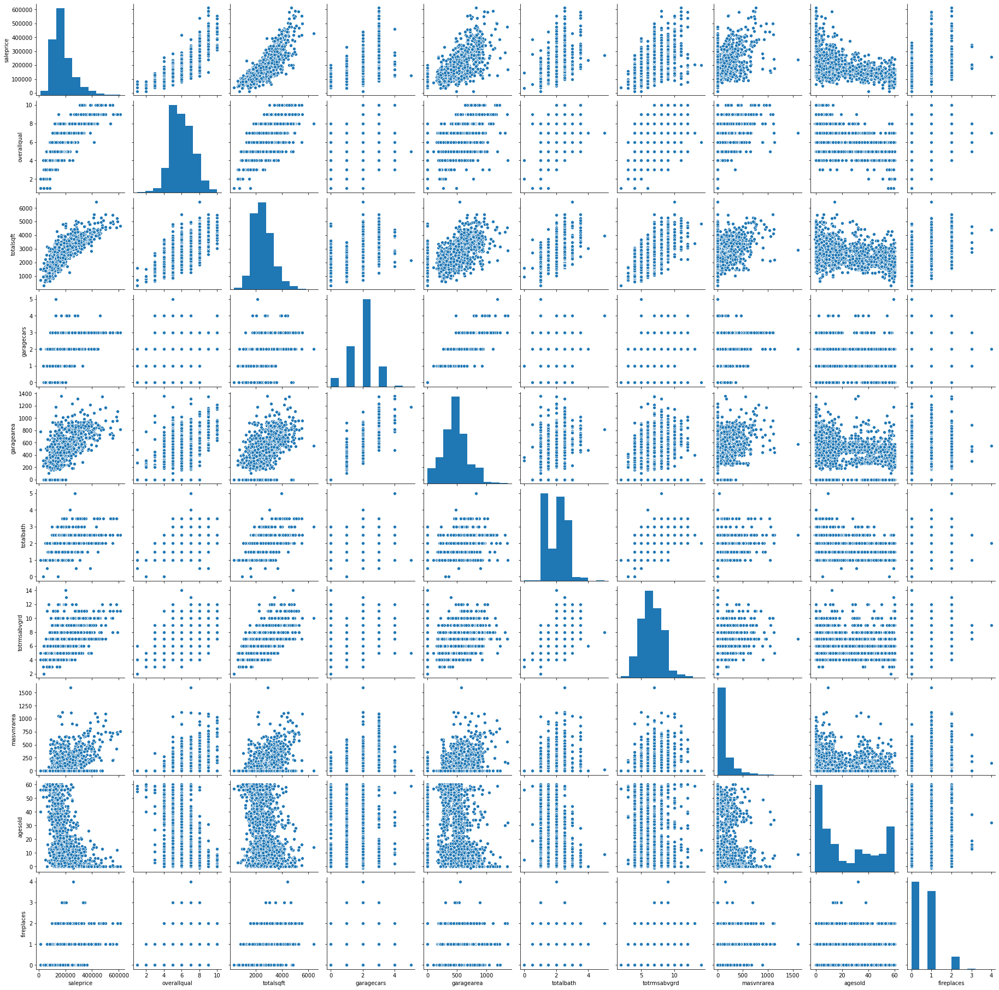

In [167]:
sns.pairplot(train_num_features);

From the num_features selected due to higher correlation to price, all the features show a linear relation to the saleprice. All the features selected except agesold shows a positive relation to price, as each feature increase the sale price increase as well. Take masvrnarea, even though the linear relation is not as obvious as the other features, it still shows that as the masvrnarea increases, sale price increases as well. As for the agesold, it shows a negative slope, however this is expected as the price of the house would increase as the house is younger. We can see that after about 5 years old, the house prices drop exponentially.

In [168]:
#Maybe do a histogram of saleprice to see what kind of range or predicting value we are working with

def subplot_histograms(dataframe, list_of_columns, list_of_xlabels):
    nrows = int(np.ceil(len(list_of_columns)/2))
    fig, ax = plt.subplots(nrows=nrows, ncols=2,figsize=(18,20))
    fig.suptitle("Distribution of numerical features",fontsize=20)
    ax = ax.ravel()
    for i, column in enumerate(list_of_columns):
        ax[i].hist(dataframe[column],bins=10)
        # Set titles, labels, etc here for each subplot
        ax[i].set_xlabel(list_of_xlabels[i],fontsize=12,c="darkblue")
        ax[i].axvline(x=dataframe[column].mean(),c='red',linestyle="dashed")
        ax[i].axvline(x=dataframe[column].median(),c='green')
        ax[i].set_ylabel("Frequency",fontsize=12,c="darkblue")

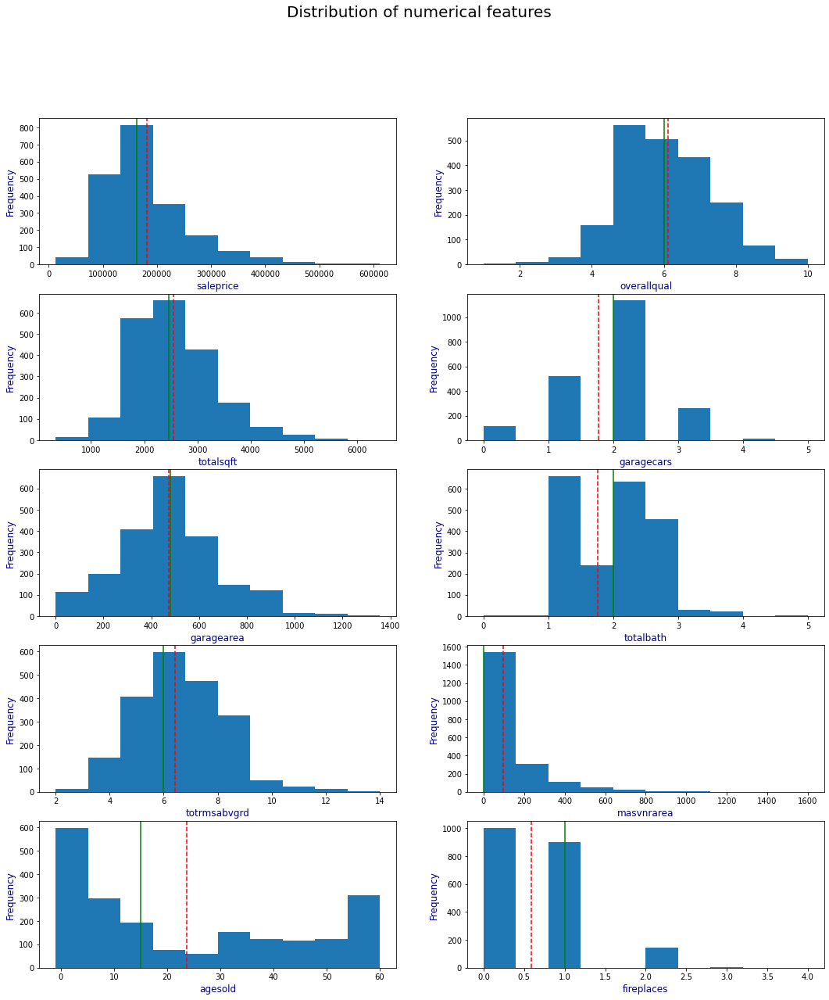

In [169]:
subplot_histograms(train_num_features, train_num_features.columns, train_num_features.columns)

The agesold shown distribution is between 0 to 60. Most of the houses fall within the 0 to 5 age which could be because most houses are sold when newly built or remodelled to sell, and would also be more popular.

The totrmsabvgrd and garagearea of the houses mostly fall in the lower to middle range which makes sense as according to the totalsqft of the house, most houses fall to the lower range of 1500 to 3500 as it is right skewed. This in turn explains the garagecars in most house to only be 2 and totalbath to be around 1 to 3 which includes full and half baths as the houses are not big. As the houses in sqft are not big, would explain why the saleprice is right skewed, meaning most houses fall in the lower range of 100,000 to 200,000. This is expected as according to the [United States Census Bureau](#Sources), the median household income is  46,127 (2014-2018) in 2018 dollars, which means that half the population in Ames has a household income of less than 46,127/year.

The masvnrarea doesn't have much of a wide distribution, its distribution is around the 0 to about 1000, with most of the houses being at the 0 to 100 range. This could be because the houses sold are generally small and cheaper, therefore, some may not even have a masonry veneer.

Most houses as can be seen in the histogram either have no fireplace or just 1. As we have seen most houses are small, and therefore could not possible have that many fireplaces.

In [170]:
cat_col_list = [x for x in train if x not in train_num_3]

In [171]:
len(cat_col_list)

39

In [172]:
def subplot_boxplot(dataframe, list_of_columns, list_of_xlabels):
    nrows = int(np.ceil(len(list_of_columns)/2))
    fig, ax = plt.subplots(nrows=nrows, ncols=2,figsize=(25,70))
    fig.suptitle("Boxplot for categorical features",fontsize=20)
    ax = ax.ravel()
    for i, column in enumerate(list_of_columns):
        sns.boxplot(data=dataframe,x=column,y='saleprice', ax=ax[i])
        # Set titles, labels, etc here for each subplot
        ax[i].set_xlabel(list_of_xlabels[i],fontsize=12,c="darkblue")
        ax[i].set_ylabel("saleprice",fontsize=12,c="darkblue")

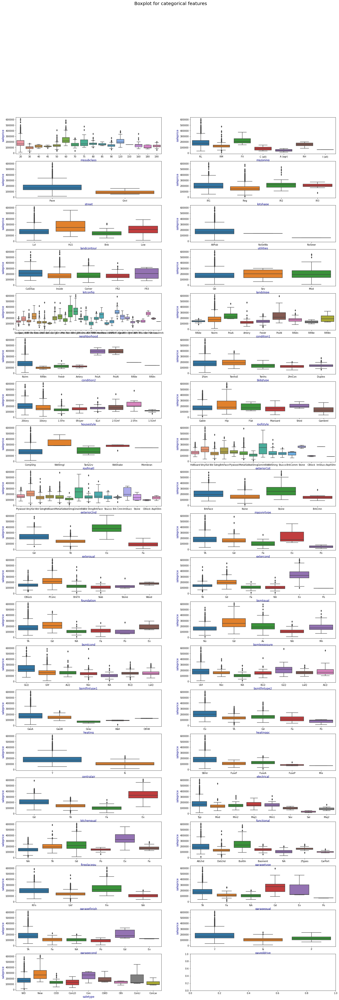

In [173]:
subplot_boxplot(train, cat_col_list, cat_col_list)

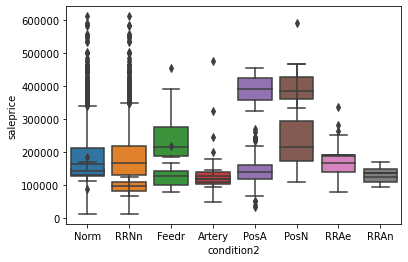

In [174]:
sns.boxplot(data=train, x='condition1', y='saleprice')

sns.boxplot(data=train, x='condition2', y='saleprice') 
#checking the relationship between condition 1 and 2 against price. For now we will keep these and do regularization later


In [175]:
train_num_features.head(1) #wanted to see the chosen features for numerical

,saleprice,overallqual,totalsqft,garagecars,garagearea,totalbath,totrmsabvgrd,masvnrarea,agesold,fireplaces
0,130500,6,2204.0,2.0,475.0,2.5,6,289.0,5,0


In [176]:
train_cat_features = train[['mssubclass', 'mszoning', 'street', 'landcontour', 'neighborhood', 'condition1', 'condition2', 'roofmatl', 'exterior1st', 'exterior2nd', 'extercond', 'bsmtqual', 'bsmtexposure', 'heating', 'heatingqc','centralair', 'kitchenqual', 'fireplacequ', 'garagetype', 'garagefinish', 'garagequal','garagecond','saletype']]

****The numerical features selected are based on the highest correlation and linearity relation to saleprice. They are 'overallqual', 'totalsqft', 'garagecars', 'garagearea', 'totalbath', 'totrmsabvgrd' and 'masvnrarea'. The categorical features selected are base on the price sensitivity of each feature to the saleprice as shown in the boxplots. They are 'mssubclass', 'mszoning', 'street', 'landcontour', 'neighborhood', 'condition1', 'condition2', 'roofmatl', 'exterior1st', 'exterior2nd', 'exterqual', 'bsmtqual', 'bsmtexposure', 'heating', 'heatingqc', 'centralair', 'kitchenqual', 'fireplacequ', 'garagetype', 'garagefinish', 'garagequal','garagecond' and 'saletype'.****

##### Encoding of the categorical features

In [177]:
train_num_features.shape

(2049, 10)

In [178]:
train_cat_features.shape

(2049, 23)

In [179]:
#Create a new dataframe for only selected features
#train_features_df = pd.merge(train_num_features, train_cat_features, how='inner') 
#realise can't use merge because dropped Id?
train_features_df = train_num_features.join(train_cat_features, how='outer')

In [180]:
train_features_df.head()

,saleprice,overallqual,totalsqft,garagecars,garagearea,totalbath,totrmsabvgrd,masvnrarea,agesold,fireplaces,mssubclass,mszoning,street,landcontour,neighborhood,condition1,condition2,roofmatl,exterior1st,exterior2nd,extercond,bsmtqual,bsmtexposure,heating,heatingqc,centralair,kitchenqual,fireplacequ,garagetype,garagefinish,garagequal,garagecond,saletype
0,130500,6,2204.0,2.0,475.0,2.5,6,289.0,5,0,60,RL,Pave,Lvl,Sawyer,RRAe,Norm,CompShg,HdBoard,Plywood,TA,TA,No,GasA,Ex,Y,Gd,NA,Attchd,RFn,TA,TA,WD
1,220000,7,3035.0,2.0,559.0,2.5,8,132.0,12,1,60,RL,Pave,Lvl,SawyerW,Norm,Norm,CompShg,VinylSd,VinylSd,TA,Gd,No,GasA,Ex,Y,Gd,TA,Attchd,RFn,TA,TA,WD
2,109000,5,2114.0,1.0,246.0,1.0,5,0.0,3,0,20,RL,Pave,Lvl,NAmes,Norm,Norm,CompShg,VinylSd,VinylSd,Gd,TA,No,GasA,TA,Y,Gd,NA,Detchd,Unf,TA,TA,WD
3,174000,5,1828.0,2.0,400.0,2.5,7,0.0,3,0,60,RL,Pave,Lvl,Timber,Norm,Norm,CompShg,VinylSd,VinylSd,TA,Gd,No,GasA,Gd,Y,TA,NA,BuiltIn,Fin,TA,TA,WD
4,138500,6,2121.0,2.0,484.0,2.0,6,0.0,17,0,50,RL,Pave,Lvl,SawyerW,Norm,Norm,CompShg,Wd Sdng,Plywood,TA,Fa,No,GasA,TA,Y,TA,NA,Detchd,Unf,TA,TA,WD


In [181]:
train_features_df.shape

(2049, 33)

In [182]:
# Encode categorical features on the new dataframe
train_features_df = pd.get_dummies(train_features_df, drop_first=True)

In [183]:
train_features_df.shape

(2049, 166)

In [184]:
train_features_df.head()

,saleprice,overallqual,totalsqft,garagecars,garagearea,totalbath,totrmsabvgrd,masvnrarea,agesold,fireplaces,mssubclass_30,mssubclass_40,mssubclass_45,mssubclass_50,mssubclass_60,mssubclass_70,mssubclass_75,mssubclass_80,mssubclass_85,mssubclass_90,mssubclass_120,mssubclass_150,mssubclass_160,mssubclass_180,mssubclass_190,mszoning_C (all),mszoning_FV,mszoning_I (all),mszoning_RH,mszoning_RL,mszoning_RM,street_Pave,landcontour_HLS,landcontour_Low,landcontour_Lvl,neighborhood_Blueste,neighborhood_BrDale,neighborhood_BrkSide,neighborhood_ClearCr,neighborhood_CollgCr,neighborhood_Crawfor,neighborhood_Edwards,neighborhood_Gilbert,neighborhood_Greens,neighborhood_GrnHill,neighborhood_IDOTRR,neighborhood_Landmrk,neighborhood_MeadowV,neighborhood_Mitchel,neighborhood_NAmes,neighborhood_NPkVill,neighborhood_NWAmes,neighborhood_NoRidge,neighborhood_NridgHt,neighborhood_OldTown,neighborhood_SWISU,neighborhood_Sawyer,neighborhood_SawyerW,neighborhood_Somerst,neighborhood_StoneBr,neighborhood_Timber,neighborhood_Veenker,condition1_Feedr,condition1_Norm,condition1_PosA,condition1_PosN,condition1_RRAe,condition1_RRAn,condition1_RRNe,condition1_RRNn,condition2_Feedr,condition2_Norm,condition2_PosA,condition2_PosN,condition2_RRAe,condition2_RRAn,condition2_RRNn,roofmatl_Membran,roofmatl_Tar&Grv,roofmatl_WdShake,roofmatl_WdShngl,exterior1st_AsphShn,exterior1st_BrkComm,exterior1st_BrkFace,exterior1st_CBlock,exterior1st_CemntBd,exterior1st_HdBoard,exterior1st_ImStucc,exterior1st_MetalSd,exterior1st_Plywood,exterior1st_Stone,exterior1st_Stucco,exterior1st_VinylSd,exterior1st_Wd Sdng,exterior1st_WdShing,exterior2nd_AsphShn,exterior2nd_Brk Cmn,exterior2nd_BrkFace,exterior2nd_CBlock,exterior2nd_CmentBd,exterior2nd_HdBoard,exterior2nd_ImStucc,exterior2nd_MetalSd,exterior2nd_Plywood,exterior2nd_Stone,exterior2nd_Stucco,exterior2nd_VinylSd,exterior2nd_Wd Sdng,exterior2nd_Wd Shng,extercond_Fa,extercond_Gd,extercond_Po,extercond_TA,bsmtqual_Fa,bsmtqual_Gd,bsmtqual_NA,bsmtqual_Po,bsmtqual_TA,bsmtexposure_Gd,bsmtexposure_Mn,bsmtexposure_NA,bsmtexposure_No,heating_GasW,heating_Grav,heating_OthW,heating_Wall,heatingqc_Fa,heatingqc_Gd,heatingqc_Po,heatingqc_TA,centralair_Y,kitchenqual_Fa,kitchenqual_Gd,kitchenqual_TA,fireplacequ_Fa,fireplacequ_Gd,fireplacequ_NA,fireplacequ_Po,fireplacequ_TA,garagetype_Attchd,garagetype_Basment,garagetype_BuiltIn,garagetype_CarPort,garagetype_Detchd,garagetype_NA,garagefinish_NA,garagefinish_RFn,garagefinish_Unf,garagequal_Fa,garagequal_Gd,garagequal_NA,garagequal_Po,garagequal_TA,garagecond_Fa,garagecond_Gd,garagecond_NA,garagecond_Po,garagecond_TA,saletype_CWD,saletype_Con,saletype_ConLD,saletype_ConLI,saletype_ConLw,saletype_New,saletype_Oth,saletype_WD
0,130500,6,2204.0,2.0,475.0,2.5,6,289.0,5,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,0,1,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,1
1,220000,7,3035.0,2.0,559.0,2.5,8,132.0,12,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,1,1,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,1
2,109000,5,2114.0,1.0,246.0,1.0,5,0.0,3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,1,0,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,1
3,174000,5,1828.0,2.0,400.0,2.5,7,0.0,3,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,

In [185]:
train['roofmatl'].value_counts()

CompShg    2024
Tar&Grv      15
WdShngl       5
WdShake       4
Membran       1
Name: roofmatl, dtype: int64

In [186]:
train['heating'].value_counts()

GasA    2016
GasW      20
Wall       6
Grav       5
OthW       2
Name: heating, dtype: int64

In [187]:
train['saletype'].value_counts()

WD       1781
New       158
COD        63
ConLD      17
CWD        10
ConLI       7
ConLw       5
Con         4
Oth         4
Name: saletype, dtype: int64

Those columns dropped from encoding are mssubclass:20, mszoning:A, Street:Gravel, landcontour:Bnk, neighborhood:Blmngtn, condition1:Artery, condition2:Artery, roofmatl:CompShg, exterior1st:AsbShng, exterior2nd:AsbShng, extercon:Ex, bsmtqual:Ex, bsmtexposure:Av, heating:GasA, heatingqc:Ex, centralair:N, kitchenqual:Ex, fireplacequ:Ex, garagetype:2Types, garagefinish:Fin, garagequal:Ex, garagecond:Ex, saletype:COD

#### Data Dictionary for Selected Features

|Feature|Type|Dataset|<div style="text-align: center">Data</div>|<div style="text-align: left">Description</div>|
|---|---|---|---|---|
|**saleprice**|*integer*|train|<div style="text-align: center">12789 to 611657</div>|<div style="text-align: left">The property's sale price in dollars which is the target variable that you're trying to predict for this challenge</div>|
|**overallqual**|*integer*|train|<div style="text-align: center">1 to 10</div>|<div style="text-align: left"><u>Overall material and finish quality:</u><br>10: Very Excellent<br>9: Excellent<br>8: Very Good<br>7: Good<br>6: Above Average<br>5: Average<br>4: Below Average<br>3: Fair<br>2: Poor<br>1: Very Poor</div>|
|**totalsqft**|*float*|train|<div style="text-align: center">334 to 6428</div>|<div style="text-align: left">The property's total size in square feet for the area of the house which includes the basement size and the house above</div>|
|**garagecars**|*float*|train|<div style="text-align: center">0 to 5</div>|<div style="text-align: left">Size of garage in car capacity</div>|
|**garagearea**|*float*|train|<div style="text-align: center">0 to 1356</div>|<div style="text-align: left">Size of garage in square feet</div>|
|**totalbath**|*float*|train|<div style="text-align: center">0 to 5</div>|<div style="text-align: left">Total number of baths in the house including fullbath and halfbath</div>|
|**totrmsabvgrd**|*integer*|train|<div style="text-align: center">2 to 14</div>|<div style="text-align: left">Total rooms above grade (does not include bathrooms)</div>|
|**masvnrarea**|*float*|train|<div style="text-align: center">0 to 1600</div>|<div style="text-align: left">Masonry veneer area in square feet</div>|
|**agesold**|*integer*|train|<div style="text-align: center">-1 to 60</div>|<div style="text-align: left">Age of the house in which it was bought base on when the house was last remodelled</div>|
|**fireplaces**|*integer*|train|<div style="text-align: center">0 to 4</div>|<div style="text-align: left">Number of fireplaces</div>|
|**mssubclass**|*unit*|train|<div style="text-align: left">20: 1-STORY 1946 & NEWER ALL STYLES<br>30: 1-STORY 1945 & OLDER<br>40: 1-STORY W/FINISHED ATTIC ALL AGES<br>45: 1-1/2 STORY - UNFINISHED ALL AGES<br>50: 1-1/2 STORY FINISHED ALL AGES<br>60: 2-STORY 1946 & NEWER<br>70: 2-STORY 1945 & OLDER<br>75: 2-1/2 STORY ALL AGES<br>80: SPLIT OR MULTI-LEVEL<br>85: SPLIT FOYER<br>90: DUPLEX - ALL STYLES AND AGES<br>120: 1-STORY PUD (Planned Unit Development) - 1946 & NEWER<br>150: 1-1/2 STORY PUD - ALL AGES<br>160: 2-STORY PUD - 1946 & NEWER<br>180: PUD - MULTILEVEL - INCL SPLIT LEV/FOYER<br>190: 2 FAMILY CONVERSION - ALL STYLES AND AGES</div>|<div style="text-align: left">The building class</div>|
|**mszoning**|*unit*|train|<div style="text-align: left">A: Agriculture<br>C: Commercial<br>FV: Floating Village Residential<br>I: Industrial<br>RH: Residential High Density<br>RL: Residential Low Density<br>RM: Residential Medium Density</div>|<div style="text-align: left">Identifies the general zoning classification of the sale</div>|
|**street**|*unit*|train|<div style="text-align: left">Grvl: Gravel<br>Pave: Paved</div>|<div style="text-align: left">Type of road access to property</div>|
|**landcontour**|*unit*|train|<div style="text-align: left">Lvl: Near Flat/Level<br>Bnk: Banked - Quick and significant rise from street grade to building<br>HLS: Hillside - Significant slope from side to side<br>Low: Depression</div>|<div style="text-align: left">Flatness of the property</div>|
|**neighborhood**|*unit*|train|<div style="text-align: left">Blmngtn: Bloomington Heights<br>Blueste: Bluestem<br>BrDale: Briardale<br>BrkSide: Brookside<br>ClearCr: Clear Creek<br>CollgCr: College Creek<br>Crawfor: Crawford<br>Edwards: Edwards<br>Gilbert: Gilbert<br>IDOTRR: Iowa DOT and Rail Road<br>MeadowV: Meadow Village<br>Mitchel: Mitchell<br>Names: North Ames<br>NoRidge: Northridge<br>NPkVill: Northpark Villa<br>NridgHt: Northridge Heights<br>NWAmes: Northwest Ames<br>OldTown: Old Town<br>SWISU: South & West of Iowa State University<br>Sawyer: Sawyer<br>SawyerW: Sawyer West<br>Somerst: Somerset<br>StoneBr: Stone Brook<br>Timber: Timberland<br>Veenker: Veenker</div>|<div style="text-align: left">Physical locations within Ames city limits</div>|
|**condition1**|*unit*|train|<div style="text-align: left">Artery: Adjacent to arterial street<br>Feedr: Adjacent to feeder street<br>Norm: Normal<br>RRNn: Within 200' of North-South Railroad<br>RRAn: Adjacent to North-South Railroad<br>PosN: Near positive off-site feature--park, greenbelt, etc.<br>PosA: Adjacent to postive off-site feature<br>RRNe: Within 200' of East-West Railroad<br>RRAe: Adjacent to East-West Railroad</div>|<div style="text-align: left">Proximity to main road or railroad</div>|
|**condition2**|*unit*|train|<div style="text-align: left">Artery: Adjacent to arterial street<br>Feedr: Adjacent to feeder street<br>Norm: Normal<br>RRNn: Within 200' of North-South Railroad<br>RRAn: Adjacent to North-South Railroad<br>PosN: Near positive off-site feature--park, greenbelt, etc.<br>PosA: Adjacent to postive off-site feature<br>RRNe: Within 200' of East-West Railroad<br>RRAe: Adjacent to East-West Railroad</div>|<div style="text-align: left">Proximity to main road or railroad</div>|
|**roofmatl**|*unit*|train|<div style="text-align: left">ClyTile: Clay or Tile<br>CompShg: Standard (Composite) Shingle<br>Membran: Membrane<br>Metal: Metal<br>Roll: Roll<br>Tar&Grv: Gravel & Tar<br>WdShake: Wood Shakes<br>WdShngl: Wood Shingles</div>|<div style="text-align: left">Roof material</div>|
|**exterior1st**|*unit*|train|<div style="text-align: left">AsbShng: Asbestos Shingles<br>AsphShn: Asphalt Shingles<br>BrkComm: Brick Common<br>BrkFace: Brick Face<br>CBlock: Cinder Block<br>CemntBd: Cement Board<br>HdBoard: Hard Board<br>ImStucc: Imitation Stucco<br>MetalSd: Metal Siding<br>Other: Other<br>Plywood: Plywood<br>PreCast: PreCast<br>Stone: Stone<br>Stucco: Stucco<br>VinylSd: Vinyl Siding<br>Wd Sdng: Wood Siding<br>WdShing: Wood Shingles</div>|<div style="text-align: left">Exterior covering on house</div>|
|**exterior2nd**|*unit*|train|<div style="text-align: left">AsbShng: Asbestos Shingles<br>AsphShn: Asphalt Shingles<br>BrkComm: Brick Common<br>BrkFace: Brick Face<br>CBlock: Cinder Block<br>CemntBd: Cement Board<br>HdBoard: Hard Board<br>ImStucc: Imitation Stucco<br>MetalSd: Metal Siding<br>Other: Other<br>Plywood: Plywood<br>PreCast: PreCast<br>Stone: Stone<br>Stucco: Stucco<br>VinylSd: Vinyl Siding<br>Wd Sdng: Wood Siding<br>WdShing: Wood Shingles</div>|<div style="text-align: left">Exterior covering on house (if more than one material)</div>|
|**extercond**|*unit*|train|<div style="text-align: left">Ex: Excellent<br>Gd: Good<br>TA: Average/Typical<br>Fa: Fair<br>Po: Poor</div>|<div style="text-align: left">Present condition of the material on the exterior</div>|
|**bsmtqual**|*unit*|train|<div style="text-align: left">Ex: Excellent (100+ inches)<br>Gd: Good (90-99 inches)<br>TA: Average/Typical (80-89 inches)<br>Fa: Fair (70-79 inches)<br>Po: Poor (<70 inches)<br>NA: No Basement</div>|<div style="text-align: left">Height of the basement</div>|
|**bsmtexposure**|*unit*|train|<div style="text-align: left">Gd: Good Exposure<br>Av: Average Exposure (split levels or foyers typically score average or above)<br>Mn: Mimimum Exposure<br>No: No Exposure<br>NA: No Basement</div>|<div style="text-align: left">Walkout or garden level basement walls</div>|
|**heating**|*unit*|train|<div style="text-align: left">GasA: Gas forced warm air furnace<br>GasW: Gas hot water or steam heat<br>Grav: Gravity furnace<br>OthW: Hot water or steam heat other than gas<br>Wall: Wall furnace</div>|<div style="text-align: left">Type of heating</div>|
|**heatingqc**|*unit*|train|<div style="text-align: left">Ex: Excellent<br>Gd: Good<br>TA: Average/Typical<br>Fa: Fair<br>Po: Poor</div>|<div style="text-align: left">Heating quality and condition</div>|
|**centralair**|*unit*|train|<div style="text-align: left">N: No<br>Y: Yes</div>|<div style="text-align: left">Central air conditioning</div>|
|**kitchenqual**|*unit*|train|<div style="text-align: left">Ex: Excellent<br>Gd: Good<br>TA: Average/Typical<br>Fa: Fair</div>|<div style="text-align: left">Kitchen quality</div>|
|**fireplacequ**|*unit*|train|<div style="text-align: left">Ex: Excellent<br>Gd: Good<br>TA: Average/Typical<br>Fa: Fair<br>Po: Poor<br>NA: No Fireplace</div>|<div style="text-align: left">Fireplace quality</div>|
|**garagetyp**|*unit*|train|<div style="text-align: left">2Types: More than one type of garage<br>Attchd: Attached to home<br>Basment: Basement Garage<br>BuiltIn: Built-In (Garage part of house - typically has room above garage)<br>CarPort: Car Port<br>Detchd: Detached from home<br>NA: No Garage</div>|<div style="text-align: left">Garage location</div>|
|**garagefinish**|*unit*|train|<div style="text-align: left">Fin: Finished<br>RFn: Rough Finished<br>Unf: Unfinished<br>NA: No Garage</div>|<div style="text-align: left">Interior finish of the garage</div>|
|**garagequal**|*unit*|train|<div style="text-align: left">Ex: Excellent<br>Gd: Good<br>TA: Average/Typical<br>Fa: Fair<br>Po: Poor<br>NA: No Garage</div>|<div style="text-align: left">Garage quality</div>|
|**garagecond**|*unit*|train|<div style="text-align: left">Ex: Excellent<br>Gd: Good<br>TA: Average/Typical<br>Fa: Fair<br>Po: Poor<br>NA: No Garage</div>|<div style="text-align: left">Garage condition</div>|
|**saletype**|*unit*|train|<div style="text-align: left">WD: Warranty Deed - Conventional<br>CWD: Warranty Deed - Cash<br>VWD: Warranty Deed - VA Loan<br>New: Home just constructed and sold<br>COD: Court Officer Deed/Estate<br>Con: Contract 15% Down payment regular terms<br>ConLw: Contract Low Down payment and low interest<br>ConLI: Contract Low Interest<br>ConLD: Contract Low Down<br>Oth: Other</div>|<div style="text-align: left">Type of sale</div>|

The original [data dictionary](https://www.kaggle.com/c/dsi-us-6-project-2-regression-challenge/data) is from Kaggle.

In [189]:
train_features_df.describe()

,saleprice,overallqual,totalsqft,garagecars,garagearea,totalbath,totrmsabvgrd,masvnrarea,agesold,fireplaces,mssubclass_30,mssubclass_40,mssubclass_45,mssubclass_50,mssubclass_60,mssubclass_70,mssubclass_75,mssubclass_80,mssubclass_85,mssubclass_90,mssubclass_120,mssubclass_150,mssubclass_160,mssubclass_180,mssubclass_190,mszoning_C (all),mszoning_FV,mszoning_I (all),mszoning_RH,mszoning_RL,mszoning_RM,street_Pave,landcontour_HLS,landcontour_Low,landcontour_Lvl,neighborhood_Blueste,neighborhood_BrDale,neighborhood_BrkSide,neighborhood_ClearCr,neighborhood_CollgCr,neighborhood_Crawfor,neighborhood_Edwards,neighborhood_Gilbert,neighborhood_Greens,neighborhood_GrnHill,neighborhood_IDOTRR,neighborhood_Landmrk,neighborhood_MeadowV,neighborhood_Mitchel,neighborhood_NAmes,neighborhood_NPkVill,neighborhood_NWAmes,neighborhood_NoRidge,neighborhood_NridgHt,neighborhood_OldTown,neighborhood_SWISU,neighborhood_Sawyer,neighborhood_SawyerW,neighborhood_Somerst,neighborhood_StoneBr,neighborhood_Timber,neighborhood_Veenker,condition1_Feedr,condition1_Norm,condition1_PosA,condition1_PosN,condition1_RRAe,condition1_RRAn,condition1_RRNe,condition1_RRNn,condition2_Feedr,condition2_Norm,condition2_PosA,condition2_PosN,condition2_RRAe,condition2_RRAn,condition2_RRNn,roofmatl_Membran,roofmatl_Tar&Grv,roofmatl_WdShake,roofmatl_WdShngl,exterior1st_AsphShn,exterior1st_BrkComm,exterior1st_BrkFace,exterior1st_CBlock,exterior1st_CemntBd,exterior1st_HdBoard,exterior1st_ImStucc,exterior1st_MetalSd,exterior1st_Plywood,exterior1st_Stone,exterior1st_Stucco,exterior1st_VinylSd,exterior1st_Wd Sdng,exterior1st_WdShing,exterior2nd_AsphShn,exterior2nd_Brk Cmn,exterior2nd_BrkFace,exterior2nd_CBlock,exterior2nd_CmentBd,exterior2nd_HdBoard,exterior2nd_ImStucc,exterior2nd_MetalSd,exterior2nd_Plywood,exterior2nd_Stone,exterior2nd_Stucco,exterior2nd_VinylSd,exterior2nd_Wd Sdng,exterior2nd_Wd Shng,extercond_Fa,extercond_Gd,extercond_Po,extercond_TA,bsmtqual_Fa,bsmtqual_Gd,bsmtqual_NA,bsmtqual_Po,bsmtqual_TA,bsmtexposure_Gd,bsmtexposure_Mn,bsmtexposure_NA,bsmtexposure_No,heating_GasW,heating_Grav,heating_OthW,heating_Wall,heatingqc_Fa,heatingqc_Gd,heatingqc_Po,heatingqc_TA,centralair_Y,kitchenqual_Fa,kitchenqual_Gd,kitchenqual_TA,fireplacequ_Fa,fireplacequ_Gd,fireplacequ_NA,fireplacequ_Po,fireplacequ_TA,garagetype_Attchd,garagetype_Basment,garagetype_BuiltIn,garagetype_CarPort,garagetype_Detchd,garagetype_NA,garagefinish_NA,garagefinish_RFn,garagefinish_Unf,garagequal_Fa,garagequal_Gd,garagequal_NA,garagequal_Po,garagequal_TA,garagecond_Fa,garagecond_Gd,garagecond_NA,garagecond_Po,garagecond_TA,saletype_CWD,saletype_Con,saletype_ConLD,saletype_ConLI,saletype_ConLw,saletype_New,saletype_Oth,saletype_WD
count,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.00000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000000,2049.000

## Data Cleaning for Test Data

In [ ]:
#Clean the test data
test.head()

In [ ]:
test.columns = test.columns.map(lambda col: (col.replace(' ','')).lower())

In [ ]:
test.head()

In [ ]:
test.shape

In [ ]:
test['id'].nunique()

In [ ]:
test.info()

In [ ]:
test['mssubclass'] = test['mssubclass'].astype(object)

In [ ]:
test['mssubclass'].dtypes

In [ ]:
test['yrblt/remod/add'] = test[['yearbuilt','yearremod/add']].max(axis=1)
test['totalsqft'] = test['grlivarea'] + test['totalbsmtsf']

In [ ]:
test['agesold'] = test['yrsold'] - test['yrblt/remod/add']

test['totalbath'] = test['fullbath'] + test['halfbath']/2

test['totalbsmtbath'] = test['bsmtfullbath'] + test['bsmthalfbath']/2

In [ ]:
#for simplicity, I shall fill the numerical null with 0, and the categorical with NA
test_num = test._get_numeric_data()
test_num.shape

In [ ]:
test_num[test_num.columns] = test_num[test_num.columns].fillna(0)

In [ ]:
test_cat_col = [x for x in test if x not in test_num]

In [ ]:
len(test_cat_col)

In [ ]:
test_cat = test[test_cat_col].fillna('NA')

In [ ]:
test_cat.shape

In [ ]:
test_num.info()

In [ ]:
test_cat.info()

In [ ]:
test_num_features = test_num[['overallqual', 'totalsqft', 'garagecars', 'garagearea', 'totalbath', 'totrmsabvgrd', 'masvnrarea', 'agesold','fireplaces']]
#getting the selected features for numerical

In [ ]:
test_cat_features = test_cat[['mssubclass', 'mszoning', 'street', 'landcontour', 'neighborhood', 'condition1', 'condition2', 'roofmatl', 'exterior1st', 'exterior2nd', 'extercond', 'bsmtqual', 'bsmtexposure', 'heating', 'heatingqc','centralair', 'kitchenqual', 'fireplacequ', 'garagetype', 'garagefinish', 'garagequal','garagecond','saletype']]
#getting the selected features for categorical

In [ ]:
test_num_features.shape

In [ ]:
test_cat_features.shape

In [ ]:
test_features_df = test_num_features.join(test_cat_features,how='inner')

In [ ]:
test_features_df.shape

In [ ]:
test_features_df = pd.get_dummies(test_features_df, drop_first=True)

In [ ]:
test_features_df.shape

In [ ]:
train_features_df.shape

In [ ]:
#should use test=train.columns.intersection(test.columns)??
#find those missing columns in the test data as compared to the train data
test_missing_columns = set([x for x in train_features_df.columns if x != 'saleprice']) - set(test_features_df.columns)
test_missing_columns

In [ ]:
for col in test_missing_columns:
    test_features_df[col] = 0   

#fill the columns that are missing in test data that are in train data

In [ ]:
test_features_df.shape 
#there are not more columns in the test data as there are some columns in test that is not in train

In [ ]:
#find those columns that are missing in train data
train_missing_columns = set(test_features_df.columns) - set(train_features_df.columns)
train_missing_columns

In [ ]:
test_features_df = test_features_df.drop(columns=train_missing_columns) 
#drop the columns in test to match the columns you used to train the model. This is usually done after training and choosing model

In [ ]:
test_features_df.shape

In [ ]:
train_features_df.shape

In [ ]:
test_features_df.columns #check the order of columns

In [ ]:
train_features_df.columns #check the order of columns

In [ ]:
test_features_df = test_features_df.reindex(train_features_df.columns,axis=1, copy=False)

# reindex to ensure both test and train columns are in same order

In [ ]:
test_features_df.columns #because reindex the test to train, the saleprice is now in test as well

In [ ]:
test_features_df.drop(columns=['saleprice'],inplace=True)

In [ ]:
test_features_df.shape #check if column was dropped

In [ ]:
test_features_df.columns #check if column was dropped

In [ ]:
test_features_df.head()

#### Save the selected and clean data for importation to do model evaluation in another notebook

In [ ]:
train_features_df.to_csv('datasets/train_features_df.csv') #saving the cleaned and formatted train data

In [ ]:
test_features_df.to_csv('datasets/test_features_df.csv') #saving the cleaned and formatted test data

## Sources

Author’s name, ***City of Ames***. Title of Document, ***showdocument?id=35206***. Title of Website, ***City of Ames***. Sponsor of Website, ***City of Ames***. Date of Access, ***November 16, 2020***. URL, https://www.cityofames.org/home/showdocument?id=35206#:~:text=Minimum%20Lot%20Frontage%2050%20ft.&text=Maximum%20Height%2085%20ft.%20or,minimum%20clearance%20of%2014%20ft.&text=Front%20Lot%20Line-,Side%20Lot%20Line%20Rear%20Lot%20Line%20Lot%20Line%20Abutting%20a,shall%20maintain%20a%2010%20ft

Author’s name, ***admin***. Title of Document, ***APA City Council and Mayoral Candidate Forum Question 3: Tiny Homes***. Title of Website, ***Ames Progressive Alliance***. Sponsor of Website, ***Ames Progressive Alliance***. Date of Document, ***October 24 2017***. Date of Access, ***November 16, 2020***. URL, https://amesprogressivealliance.org/apa-city-council-and-mayoral-candidate-forum-question-3-tiny-homes/#:~:text=City%20of%20Ames%20zoning%20regulations,be%20built%20on%20a%20foundation

Author’s name, ***U.S. Department of Commerce***. Title of Document, ***QuickFacts Ames city, Iowa***. Title of Website, ***United States Census Bureau***. Sponsor of Website, ***United States Census Bureau***. Date of Document, ***2019***. Date of Access, ***November 16, 2020***. URL, https://www.census.gov/quickfacts/fact/table/amescityiowa/INC110218

## Conclusions

The selected features that have been saved and imported to another notebook for model evaluation, were based on the relation between each features and the sale price. For the numerical features that were selected they are based on the correlation with a threshold set at 40% for both postive and negative correlation. They were also linearly related to price, meaning that there was a linear relationship where if the value of the feature increases, the price increases or decreases (this was seen in the pairplot). The categorical features chosen were base on the price sensitivity between each category of a feature as seen in the boxplot. If about one-third of the categories of a feature have a price difference of about 100,000 between the min and min or max and max of the 75% quartile between them, these were then selected as it would be features that would halp in training the model for price predictions. There are a few limitations to the features selected due to the range of data we have which might limit the models. For example, the range of age of houses when they were sold were mostly new (5 years or earlier) and there is very little data of houses sold in the range of 10 to 50 years old especially between 20 to 30, this might limit the ability to predict accurately the houses in those range. Another limitation could be that the model might not be good at predciting the houses that are bigger and more expensive. This is because the data is more skewed towards the houses that are smaller, which in turn is cheaper. The model would do well for Ames, Iowa as the houses sold are in the lower range prices as seen from the graph and therefore tend to be smaller in size as well. Therefore, if we were to use this model for prediction of sale prices of houses in areas or states that have a higher household income, houses that have bigger square footage, resulting in higher sale price of houses, the model using these data, might not be as useful in prediction.